In [7]:
import os
import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt 
from tensorflow.python.keras.utils.np_utils import to_categorical
import tensorflow as tf

from tensorflow import keras
from sklearn.preprocessing import LabelBinarizer
import pickle
from sklearn.model_selection import train_test_split

lb = LabelBinarizer()

# Preprocess data

In [13]:
def preprocess_annotations(df, image_dir):
    # Convert 'category_id' to int64 if necessary
    df['category_id'] = df['category_id'].astype('int64')
    # Replace numeric class designation with the text label of the class
    df['category_id'] = df['category_id'].replace({1: 'Penguin', 2: 'Turtle'})
    # Create the full filepath in the 'filepaths' column
    df['filepaths'] = [os.path.join(image_dir, file_path) for file_path in sorted(os.listdir(image_dir))]
    # Drop unnecessary columns
    df.drop(['id', 'area', 'segmentation', 'iscrowd'], axis=1, inplace=True)
    images = []
    bboxes = []
    labels =[] 
    for i, row in df.iterrows():        
        image_path = row["filepaths"]
        (minX, minY, w, h) = row['bbox']
        maxX = minX + w
        maxY = minY + h
        
        image = cv2.imread(image_path)
        (height, width) = image.shape[:2]
        
        minX = float(minX) / width
        maxX = float(maxX) / width
        minY = float(minY) / height
        maxY = float(maxY) / height
        
        image = tf.keras.utils.img_to_array(tf.keras.utils.load_img(image_path, target_size=(224, 224)))
        
        images.append(image)
        labels.append(row['category_id'])
        bboxes.append((minX, minY, maxX, maxY))
    
    images = np.array(images, dtype="float32") / 255.0
    bboxes = np.array(bboxes, dtype="float32")
    
    return images , labels, bboxes

train_anno_path = 'train_annotations'
valid_df_path = 'valid_annotations'
train_image_dir = 'train/train'
valid_image_dir = 'valid/valid'

import os.path
os.path.isfile(train_anno_path)

# Read the train and valid annotations
train_anno = pd.read_json(train_anno_path)
valid_anno = pd.read_json(valid_df_path)

# Preprocess the train and valid annotations
train_images, train_labels, train_bboxes = preprocess_annotations(train_anno, train_image_dir)
valid_images, valid_labels, valid_bboxes = preprocess_annotations(valid_anno, valid_image_dir)



train_labels = lb.fit_transform(train_labels)
train_labels = to_categorical(train_labels)


In [ ]:
# f = open("lb_vgg16.pickle", "wb")
# f.write(pickle.dumps(lb))
# f.close()

In [14]:
train_images, test_images, train_labels, test_labels, train_bboxes, test_bboxes = train_test_split(
    train_images, train_labels, train_bboxes, test_size=0.2, random_state=42)

# **VGG16 Model from scratch**

In [18]:
# Define the model architecture
model = tf.keras.Sequential()
model.add(tf.keras.layers.Conv2D(input_shape=(224,224,3),filters=64,kernel_size=(3,3),padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=64,kernel_size=(3,3),padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
model.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
model.add(tf.keras.layers.Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=256, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.Conv2D(filters=512, kernel_size=(3,3), padding="same", activation="relu"))
model.add(tf.keras.layers.MaxPool2D(pool_size=(2,2),strides=(2,2),name='vgg16'))
model.add(tf.keras.layers.Flatten(name='flatten'))
model.add(tf.keras.layers.Dense(256, activation='relu', name='fc1'))
model.add(tf.keras.layers.Dense(128, activation='relu', name='fc2'))
model.add(tf.keras.layers.Dense(2, activation='sigmoid', name='output'))

# Compile the model
model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=1e-4, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])
checkpoint = tf.keras.callbacks.ModelCheckpoint("vgg16_1.keras", monitor='val_acc', verbose=1, save_best_only=True, save_weights_only=False, mode='auto', save_freq=1)
early = tf.keras.callbacks.EarlyStopping(monitor='val_acc', min_delta=0, patience=20, verbose=1, mode='auto')

# Train the model
history = model.fit(train_images, train_labels, epochs=20, batch_size=20, validation_data=(test_images, test_labels), callbacks = [checkpoint,early])

Epoch 1/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 3:17 10s/step - accuracy: 0.5000 - loss: 0.6927

d:\Code\Turtle-vs-Penguin\venv\Lib\site-packages\keras\src\callbacks\model_checkpoint.py:199: UserWarning: Can save best model only with val_acc available, skipping.
  self._save_model(epoch=self._current_epoch, batch=batch, logs=logs)


11/20 ━━━━━━━━━━━━━━━━━━━━ 1:03 7s/step - accuracy: 0.4930 - loss: 0.6930

KeyboardInterrupt: 

In [ ]:
from sklearn.metrics import accuracy_score
predictions = model.predict(valid_images)
label_predicted = []
for pred in predictions:
    i = np.argmax(pred)
    if i:
        label_predicted.append("Turtle")
    else:
        label_predicted.append("Penguin")
print(f"Accuracy: {accuracy_score(valid_labels, label_predicted)}")

        

3/3 [==============================] - 3s 395ms/step
Accuracy: 0.5


### The accuracy for VG16 from scratch proof to be very low in accurary, hence, we have to propose a better solution to it

# **VGG16 model from imagenet**
First, we import the model from image net, which is already trained with 1000 classes of objects. As it is already trained with 1000 classes of objects, we should remove the top layer (The classification layers using softmax at last) and put a new layer so that we could train to specially detect 2 classes in this problems (which is turtle and penguin).

In [ ]:
from tensorflow.keras.applications import VGG16
vgg16_pretrained = VGG16(weights="imagenet", # import model from imagenet
            include_top=False,               # remove top layer, to add our specific layer in
            input_shape=(224, 224, 3))       # make sure to have the same shape as our input
vgg16_pretrained.summary()                   # let check our model summary

58889256/58889256 [==============================] - 0s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                              

In [ ]:


# as the pre-trained model is already great at extracting feature (using the 5 convolution layers), therefore we dont want it to get modified
vgg16_pretrained.trainable = False 
# turn this into to single channel
flatten = Flatten()(vgg16_pretrained.output)

# the "old" class output channel with just a change of classes 
classOutput = Dense(512, activation="relu")(flatten)
classOutput = Dropout(0.5)(classOutput)
classOutput = Dense(512, activation="relu")(classOutput)
classOutput = Dropout(0.5)(classOutput)
classOutput = Dense(2, activation="softmax", name="class")(classOutput) # 2 classes, therefore unit is 2

# An extra output channel to predict the bounding box 
bboxOutput = Dense(128, activation="relu")(flatten)
bboxOutput = Dense(64, activation="relu")(bboxOutput)
bboxOutput = Dense(32, activation="relu")(bboxOutput)
bboxOutput = Dense(4, activation="sigmoid", name="bbox")(bboxOutput) # as we need 4 point for bounding box, therefore 4 results returned are needed

# build the model with 2 ouputs channel
vgg16_tailored = Model(
    inputs=vgg16_pretrained.input,
    outputs=(classOutput,bboxOutput))

vgg16_tailored.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 224, 224, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 224, 224, 64  36928       ['block1_conv1[0][0]']           
                                )                                                             

In [ ]:
epoch = 20
batch_size = 30

In [ ]:
losses = {
    "class": "categorical_crossentropy",
    "bbox": "mean_squared_error",
}

trainTargets = {
    "class": train_labels,
    "bbox": train_bboxes
}

testTargets = {
    "class": test_labels,
    "bbox": test_bboxes
}

validTargets = {
    "class": valid_labels,
    "bbox": valid_bboxes
}

In [ ]:
vgg16_tailored.compile(loss=losses, 
                      optimizer='adam', 
                      metrics=["accuracy"])

history = vgg16_tailored.fit(train_images, trainTargets,
                            validation_data=(test_images, testTargets),
                            batch_size=batch_size,
                            epochs=epoch,
                            verbose=1)

Epoch 1/20
14/14 [==============================] - 8s 190ms/step - loss: 46.1002 - class_loss: 46.0316 - bbox_loss: 0.0686 - class_accuracy: 0.6075 - bbox_accuracy: 0.5950 - val_loss: 74.4661 - val_class_loss: 74.3780 - val_bbox_loss: 0.0881 - val_class_accuracy: 0.7600 - val_bbox_accuracy: 0.5500
Epoch 2/20
14/14 [==============================] - 1s 87ms/step - loss: 404.0401 - class_loss: 403.9930 - bbox_loss: 0.0471 - class_accuracy: 0.7575 - bbox_accuracy: 0.7325 - val_loss: 1266.5312 - val_class_loss: 1266.4515 - val_bbox_loss: 0.0797 - val_class_accuracy: 0.8200 - val_bbox_accuracy: 0.5600
Epoch 3/20
14/14 [==============================] - 1s 86ms/step - loss: 707.3000 - class_loss: 707.2583 - bbox_loss: 0.0418 - class_accuracy: 0.7625 - bbox_accuracy: 0.8225 - val_loss: 1328.8600 - val_class_loss: 1328.7834 - val_bbox_loss: 0.0765 - val_class_accuracy: 0.8200 - val_bbox_accuracy: 0.6700
Epoch 4/20
14/14 [==============================] - 1s 86ms/step - loss: 290.8554 - class_

In [ ]:
# vgg16_tailored.save("model_VGG16", save_format="h5")

In [ ]:
import math
def calculate_iou(box1, box2):
    x1_box1, y1_box1, x2_box1, y2_box1 = box1
    x1_box2, y1_box2, x2_box2, y2_box2 = box2

    x_intersection1 = max(x1_box1, x1_box2)
    y_intersection1 = max(y1_box1, y1_box2)
    x_intersection2 = min(x2_box1, x2_box2)
    y_intersection2 = min(y2_box1, y2_box2)

    intersection_area = max(0, x_intersection2 - x_intersection1 + 1) * max(0, y_intersection2 - y_intersection1 + 1)

    area_box1 = (x2_box1 - x1_box1 + 1) * (y2_box1 - y1_box1 + 1)
    area_box2 = (x2_box2 - x1_box2 + 1) * (y2_box2 - y1_box2 + 1)

    union_area = area_box1 + area_box2 - intersection_area

    iou = intersection_area / union_area

    return iou

def calculate_distance_between_centers(box1, box2):
    x1_box1, y1_box1, x2_box1, y2_box1 = box1
    x1_box2, y1_box2, x2_box2, y2_box2 = box2

    center_x1, center_y1 = (x1_box1 + x2_box1) / 2, (y1_box1 + y2_box1) / 2
    center_x2, center_y2 = (x1_box2 + x2_box2) / 2, (y1_box2 + y2_box2) / 2

    distance = math.sqrt((center_x2 - center_x1)**2 + (center_y2 - center_y1)**2)

    return distance


3/3 [==============================] - 0s 68ms/step
(79.45000267028809, 32.55000066757202, 183.75, 216.2999973297119)
(43.49166297912598, 29.329165935516357, 191.76788711547852, 215.1503448486328)


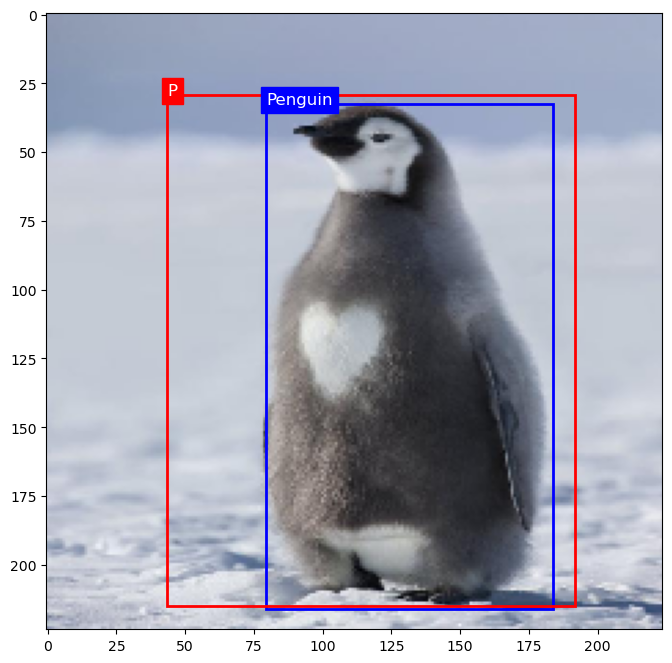

(73.85000133514404, 69.29999732971191, 223.65000534057617, 159.9500026702881)
(56.01351833343506, 67.14648342132568, 214.0534439086914, 152.95622444152832)


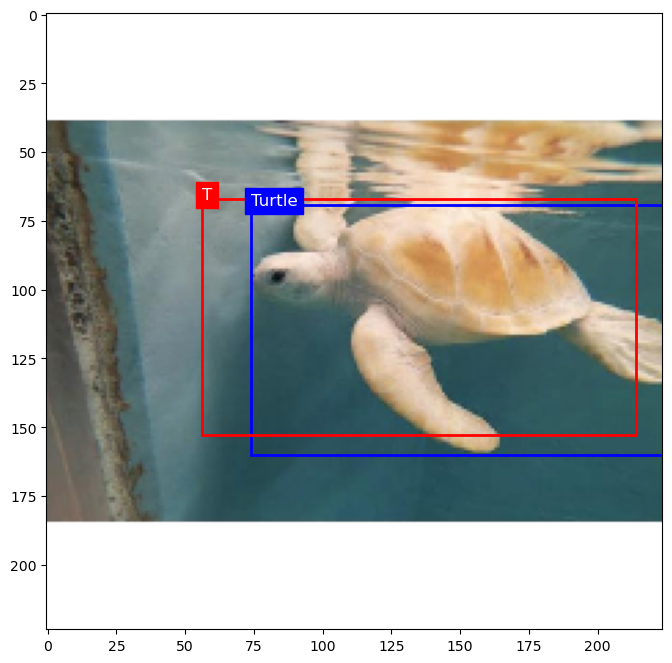

(0.0, 85.04999732971191, 179.2000026702881, 178.5)
(4.413233518600464, 81.01949787139893, 203.77469062805176, 171.81983375549316)


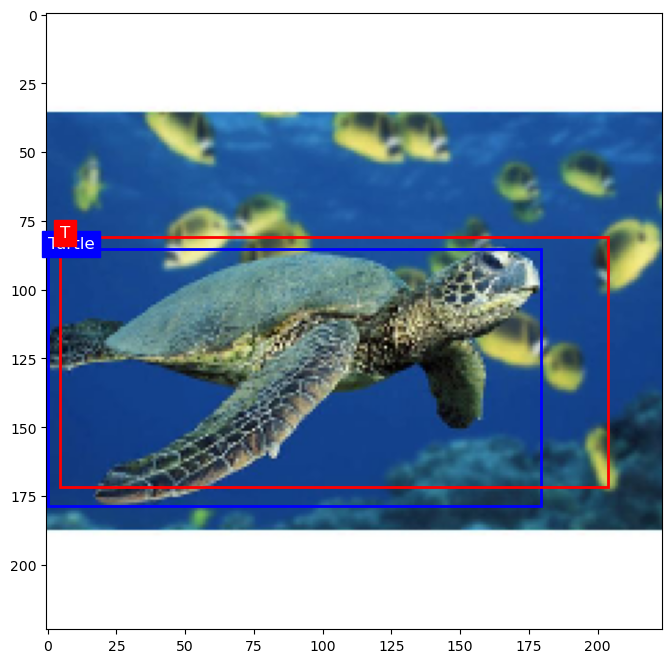

(44.80000066757202, 62.299997329711914, 204.75, 186.2000026702881)
(29.80784845352173, 76.88408946990967, 202.97822380065918, 200.08602142333984)


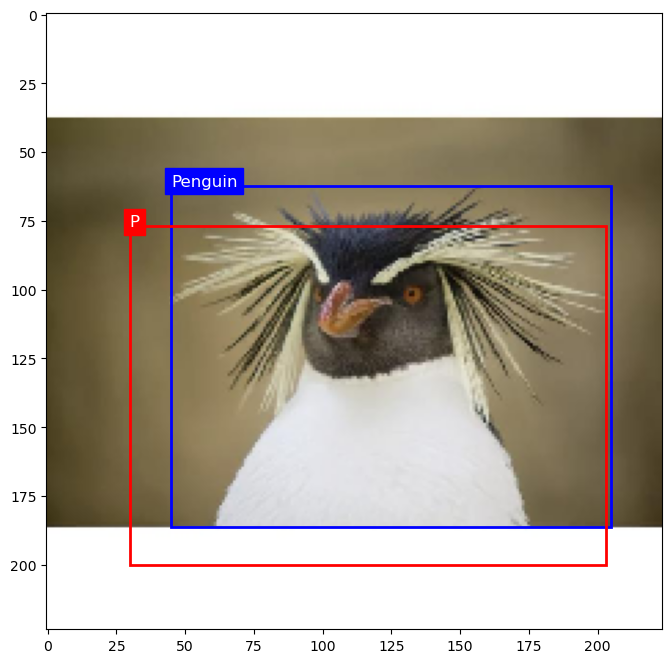

(58.799997329711914, 45.85000133514404, 162.40000534057617, 210.0)
(38.91522979736328, 53.38020706176758, 179.96964645385742, 207.20912170410156)


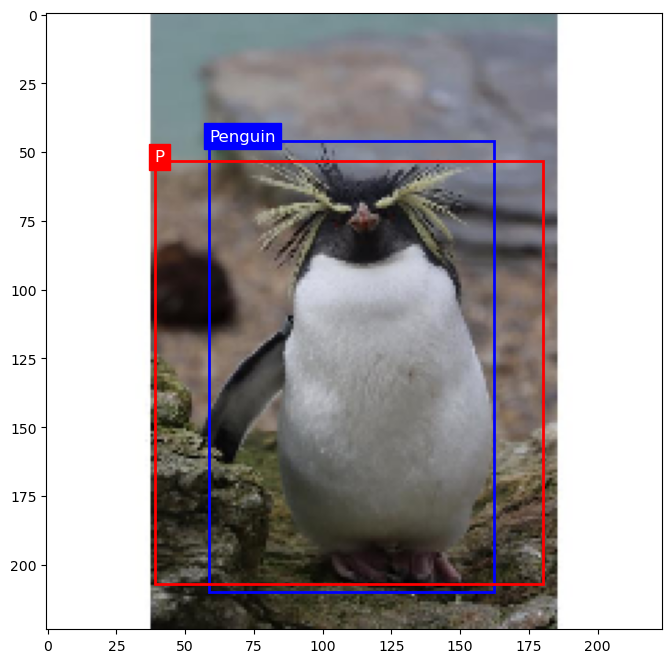

(2.1000000834465027, 42.35000133514404, 157.84999465942383, 207.2000026702881)
(3.2274048924446106, 32.23816108703613, 162.50884628295898, 204.26466178894043)


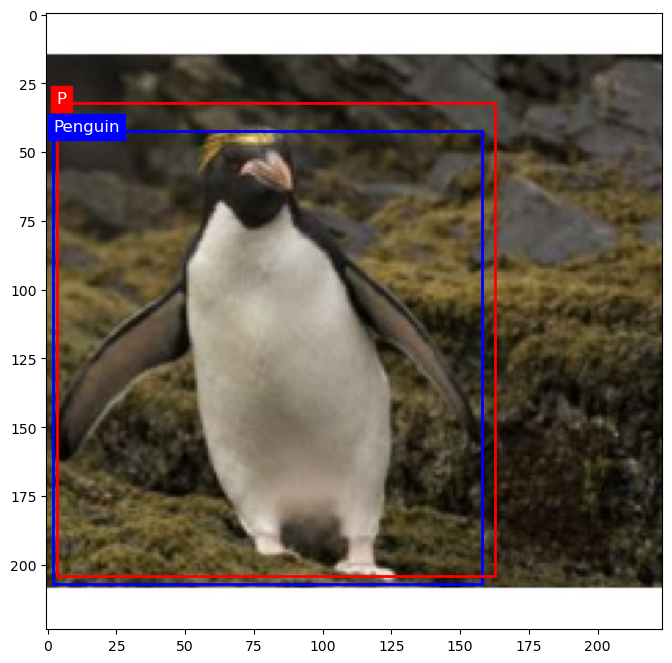

(22.05000066757202, 56.35000133514404, 175.34999465942383, 169.0499973297119)
(15.08976125717163, 47.52858781814575, 206.8464698791504, 189.8511142730713)


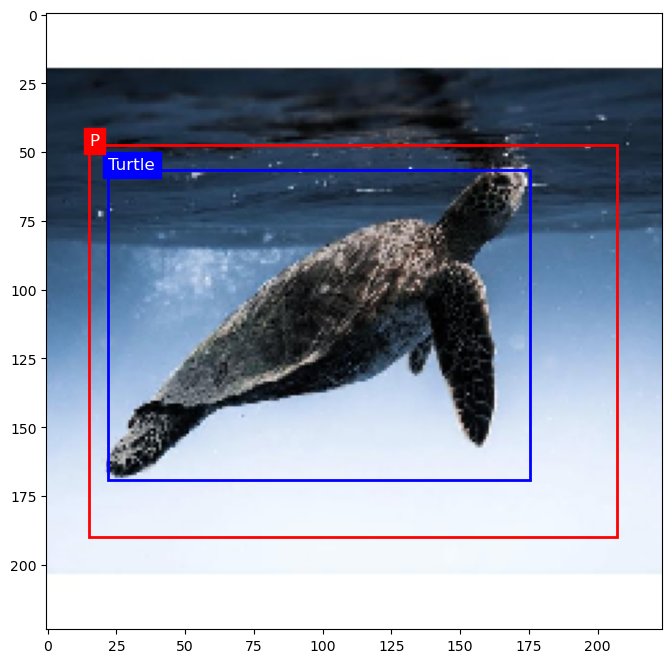

(65.79999732971191, 88.20000267028809, 154.7000026702881, 184.7999973297119)
(50.79086208343506, 93.59814357757568, 140.92432022094727, 203.02636909484863)


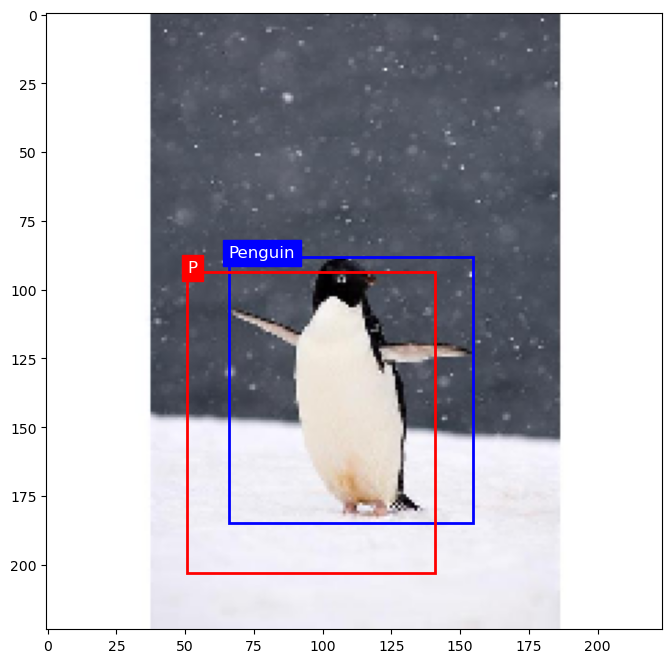

(131.25, 82.95000267028809, 197.40000534057617, 193.2000026702881)
(81.11640930175781, 68.052565574646, 209.89623260498047, 191.18866157531738)


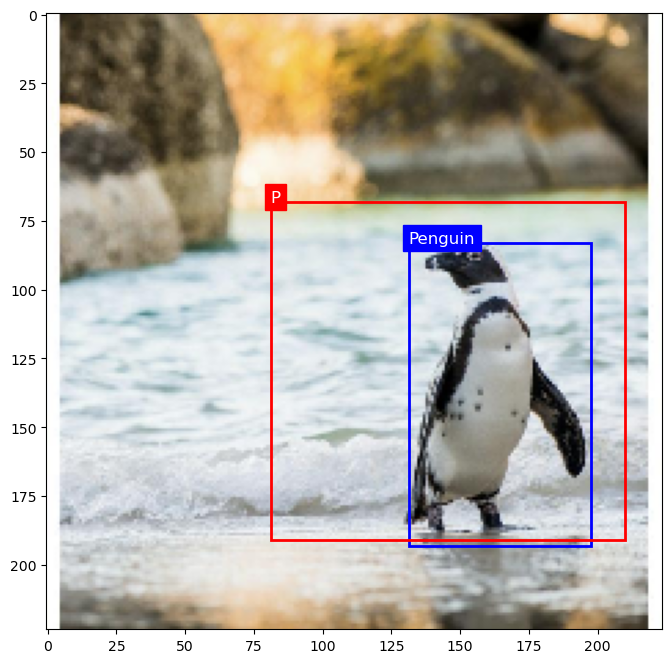

(127.40000534057617, 78.04999732971191, 176.75, 164.15000534057617)
(98.016282081604, 84.02416610717773, 186.37479972839355, 150.92348098754883)


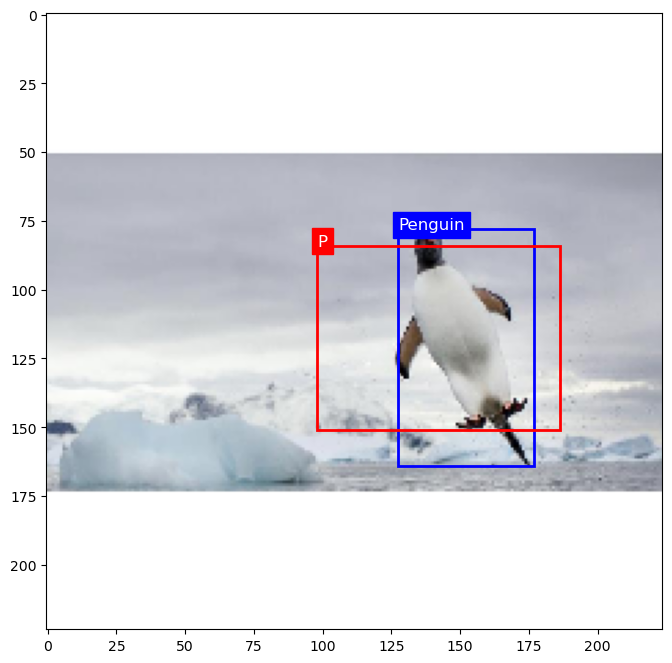

(54.25, 60.549997329711914, 224.0, 186.5499973297119)
(37.91129493713379, 65.7535810470581, 190.7425765991211, 163.18177223205566)


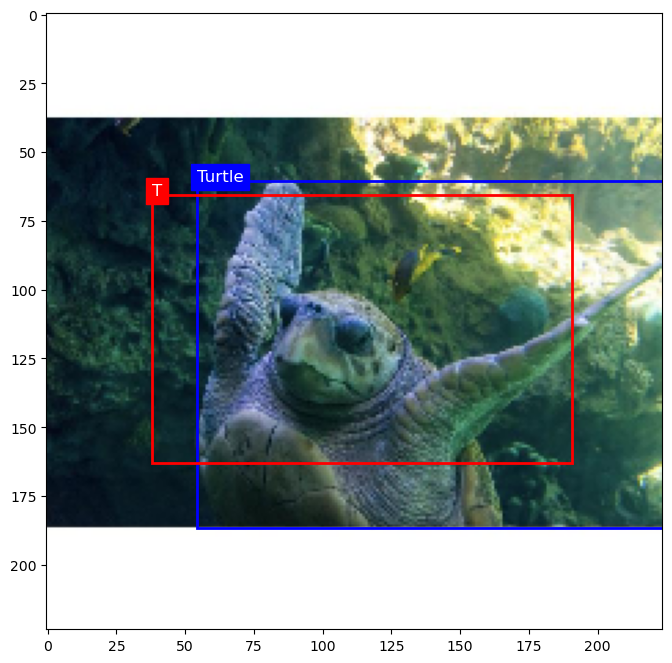

(46.55000066757202, 94.85000133514404, 169.40000534057617, 135.4500026702881)
(30.982441425323486, 102.93695545196533, 167.06521224975586, 156.64545440673828)


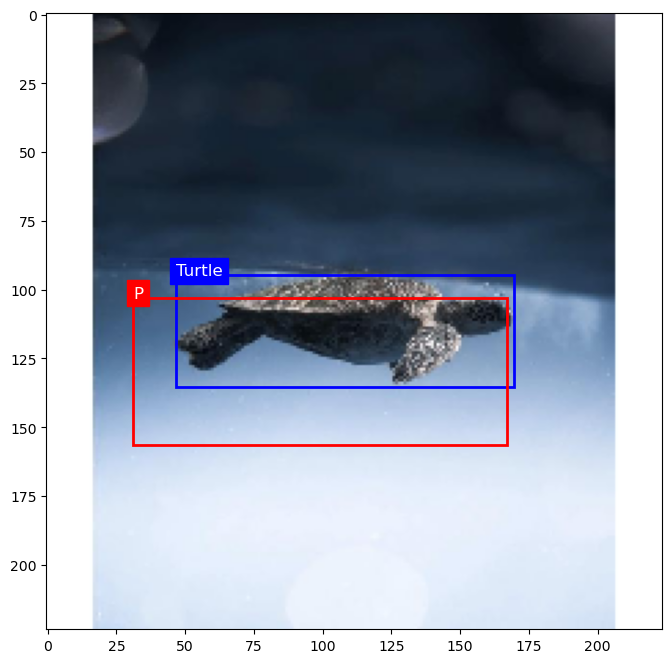

(49.35000133514404, 13.65000033378601, 224.0, 147.34999465942383)
(31.908437252044678, 25.06300187110901, 215.36272621154785, 148.085205078125)


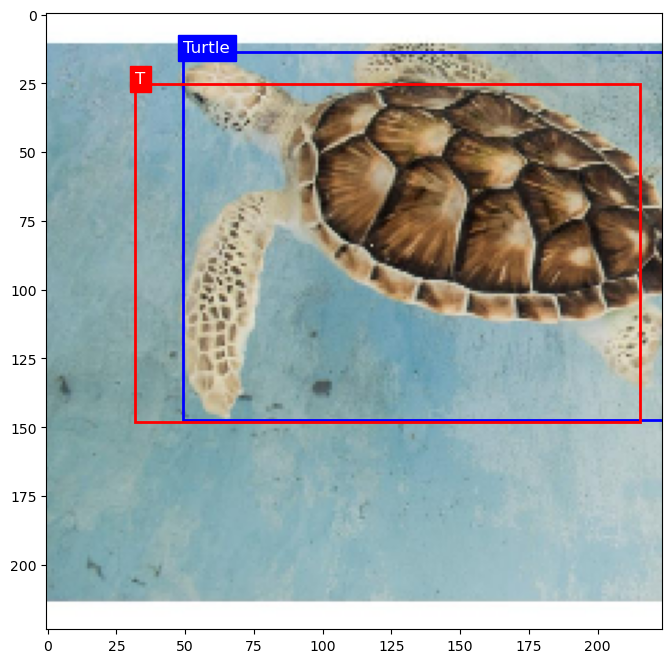

(44.10000133514404, 144.90000534057617, 181.65000534057617, 197.75)
(32.53103494644165, 78.6000165939331, 198.715576171875, 194.1230010986328)


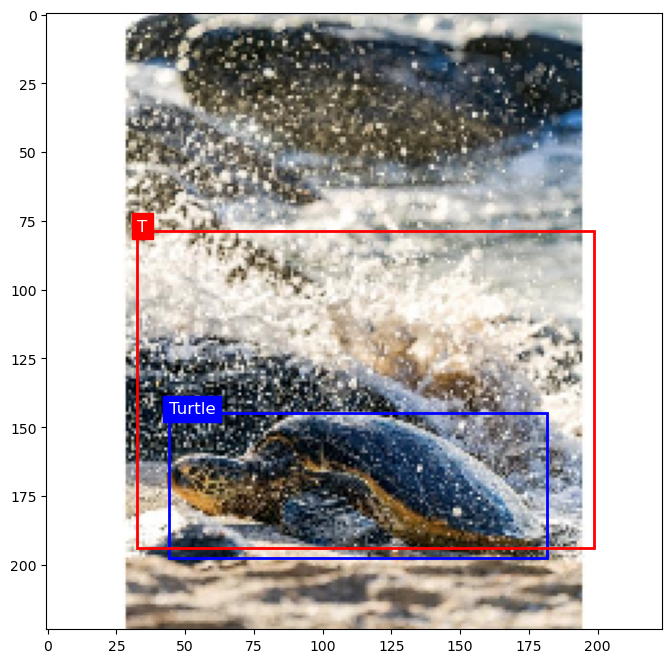

(62.299997329711914, 41.64999866485596, 162.40000534057617, 210.7000026702881)
(30.045998096466064, 32.854440212249756, 190.60159873962402, 212.4939422607422)


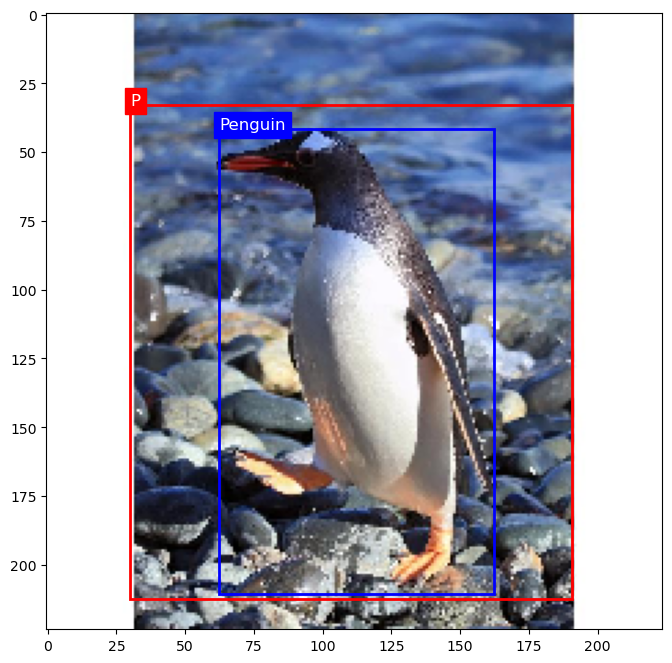

(127.04999732971191, 65.45000267028809, 216.2999973297119, 142.09999465942383)
(77.63962078094482, 71.7813892364502, 201.7638168334961, 153.42576789855957)


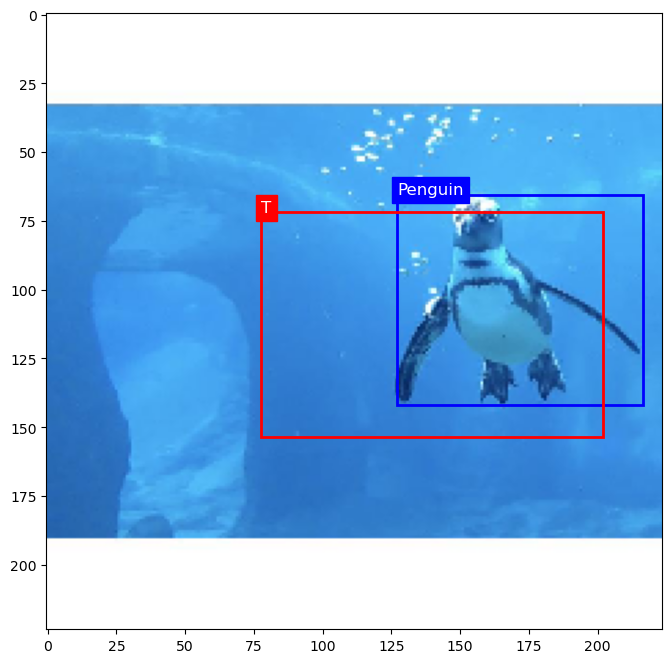

(36.05000066757202, 58.450002670288086, 209.65000534057617, 151.5499973297119)
(17.751020431518555, 79.34367847442627, 187.10655212402344, 156.2532024383545)


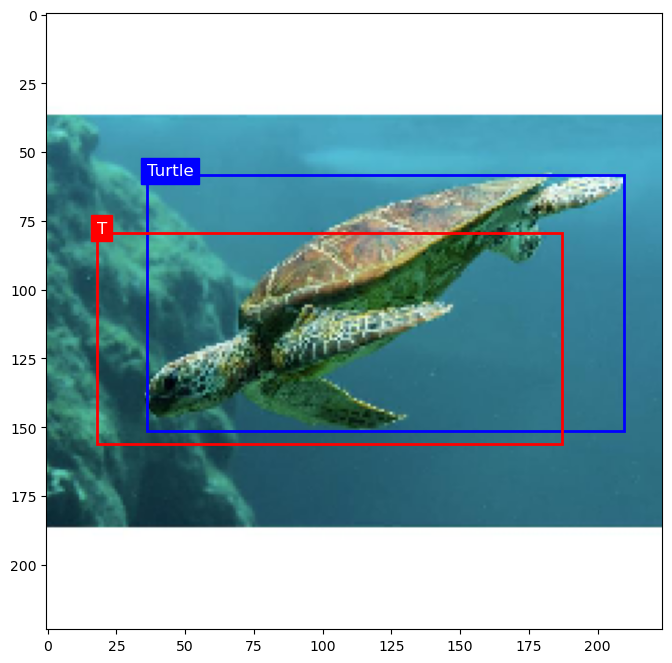

(21.0, 58.450002670288086, 191.09999465942383, 224.0)
(23.289408206939697, 38.19337749481201, 200.41532135009766, 221.75040245056152)


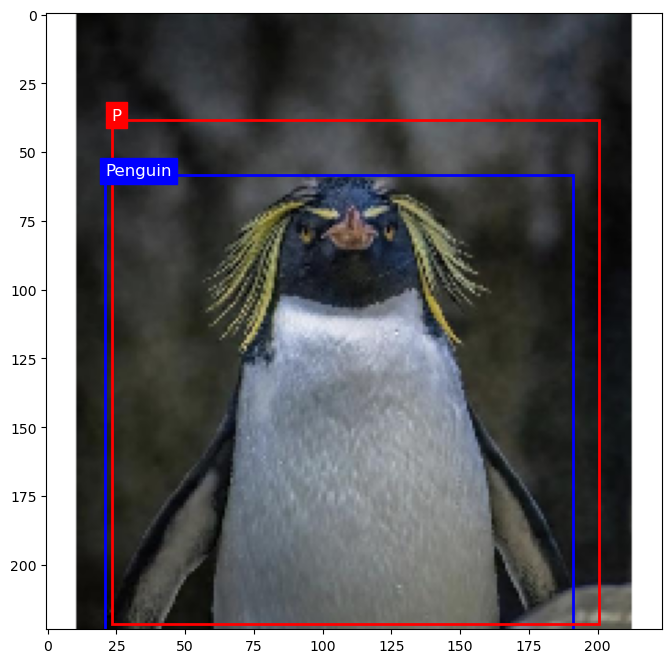

(57.39999866485596, 99.39999866485596, 112.0, 124.95000267028809)
(50.87764644622803, 86.37849235534668, 161.85864448547363, 148.64057159423828)


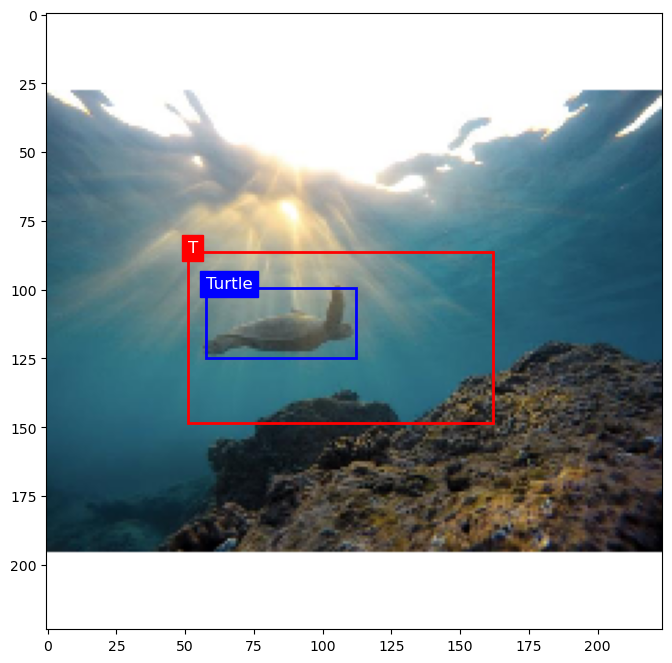

(39.89999866485596, 71.75, 218.75, 149.7999973297119)
(15.58835744857788, 82.42730712890625, 206.78936576843262, 154.9997158050537)


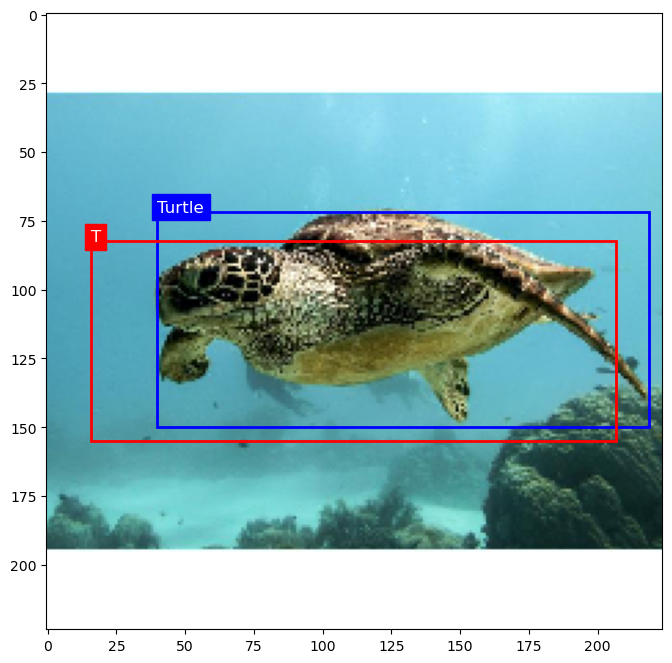

(47.94999933242798, 38.85000133514404, 186.5499973297119, 180.59999465942383)
(46.36630153656006, 66.10631942749023, 191.42026901245117, 188.7592601776123)


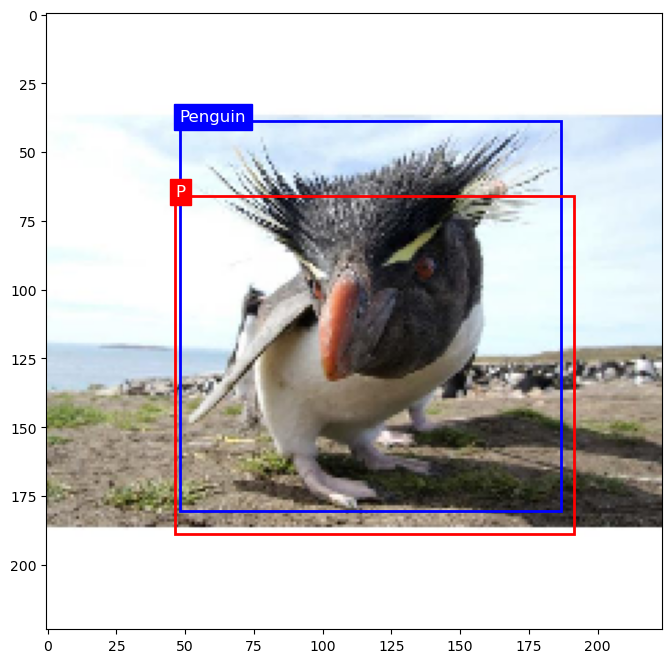

(55.64999866485596, 112.34999465942383, 154.7000026702881, 191.7999973297119)
(14.187627792358398, 102.40988731384277, 192.34876823425293, 216.32528495788574)


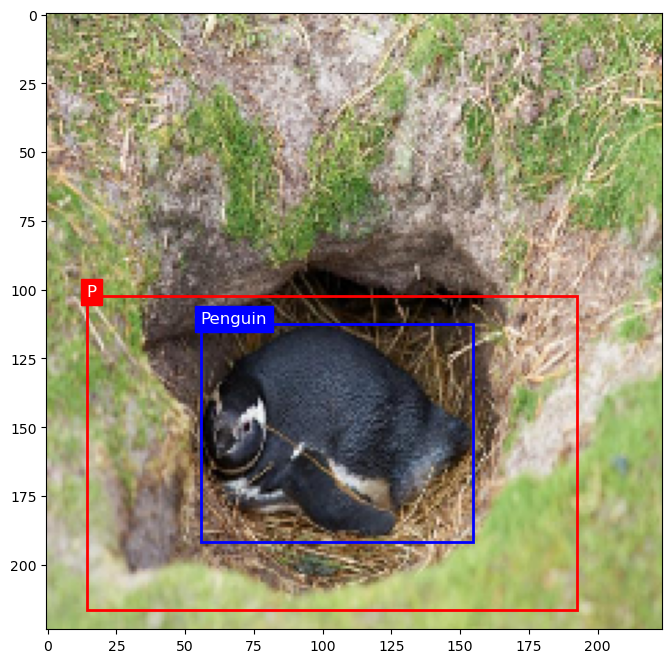

(0.0, 79.79999732971191, 144.90000534057617, 152.59999465942383)
(38.03190517425537, 82.25606155395508, 141.8122844696045, 129.0776138305664)


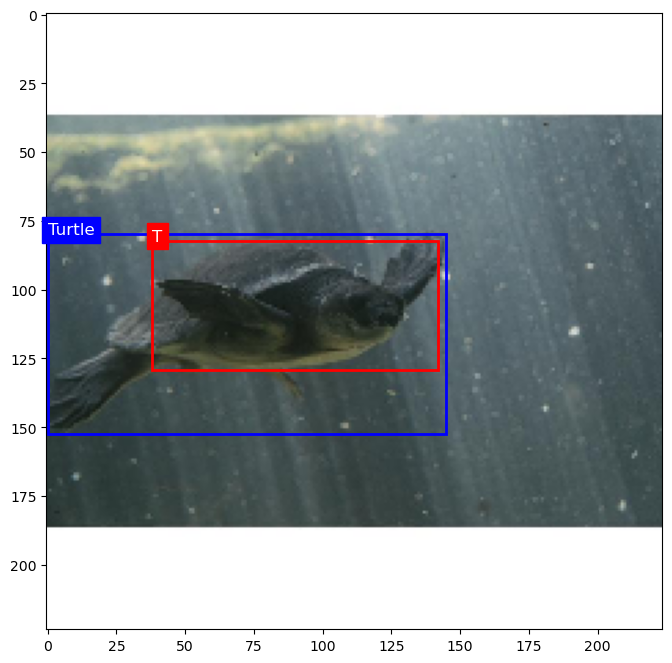

(54.60000133514404, 86.79999732971191, 179.90000534057617, 186.5499973297119)
(28.253026485443115, 82.14322185516357, 208.26365852355957, 198.77576446533203)


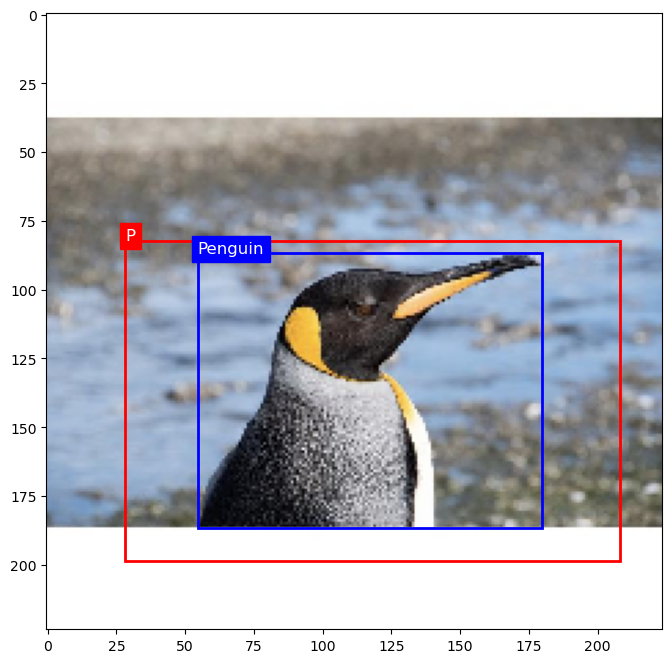

(15.050000667572021, 48.30000066757202, 105.35000133514404, 184.09999465942383)
(2.89326548576355, 44.25773859024048, 92.59083080291748, 181.5889492034912)


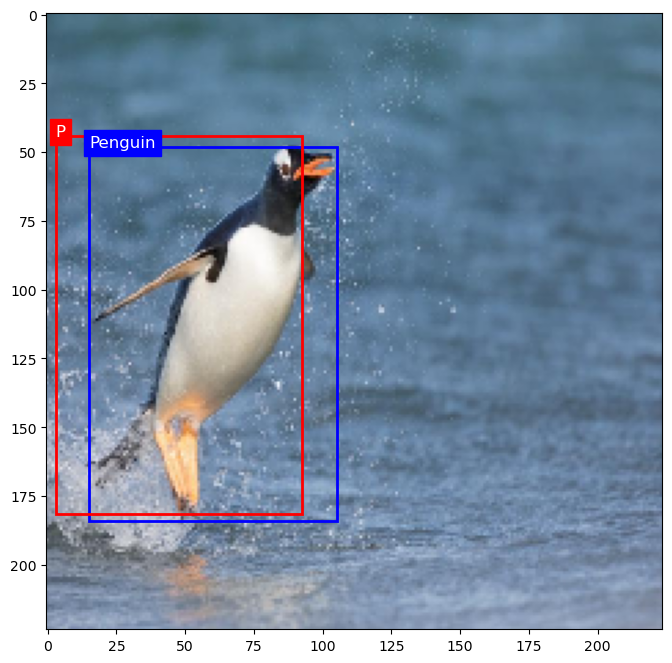

(12.25, 73.14999866485596, 223.65000534057617, 144.2000026702881)
(5.786804676055908, 88.75519561767578, 211.02685928344727, 155.26021575927734)


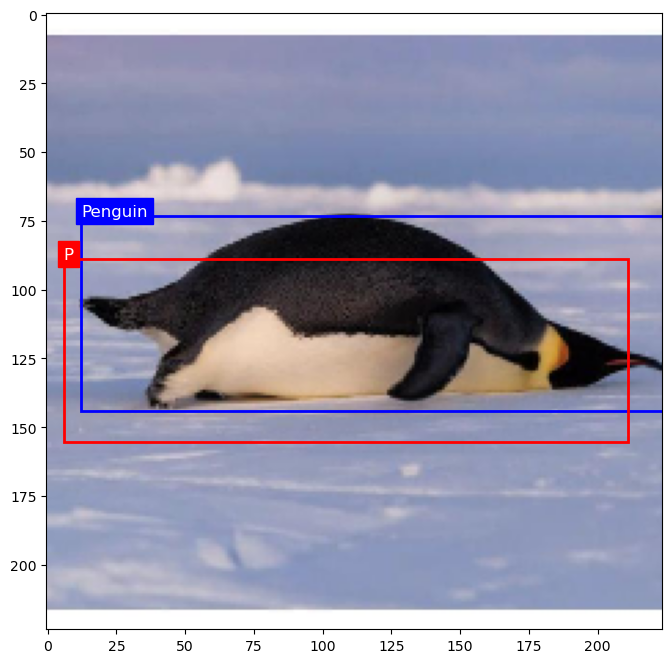

(1.4000000208616257, 59.14999866485596, 171.5, 181.65000534057617)
(16.032957077026367, 77.2449254989624, 194.38894844055176, 150.0510711669922)


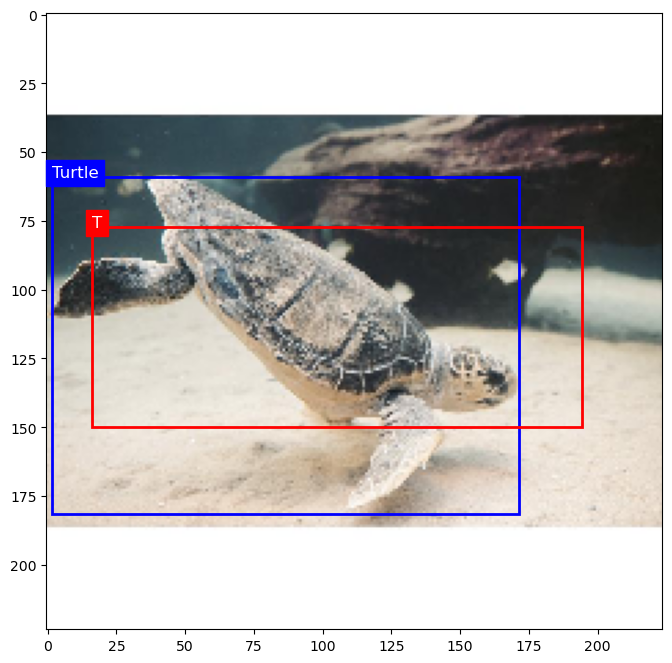

(88.20000267028809, 58.799997329711914, 224.0, 135.09999465942383)
(52.809916973114014, 72.34821796417236, 211.31801414489746, 132.6480827331543)


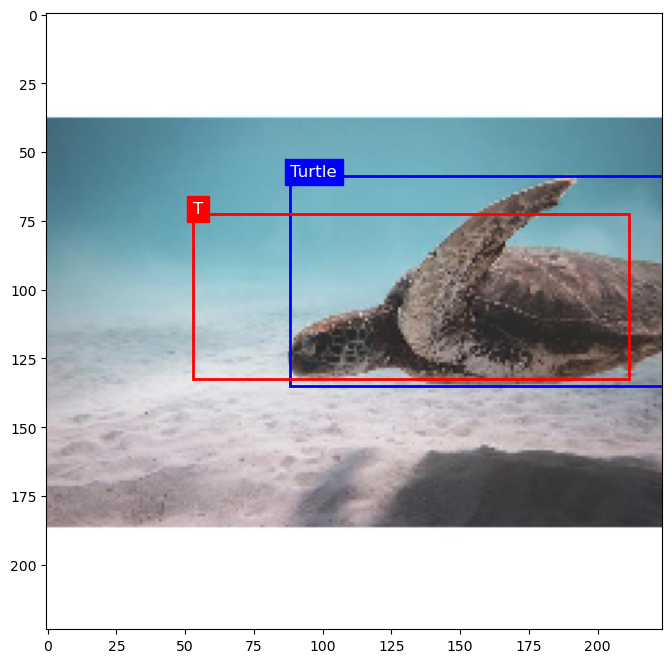

(78.04999732971191, 89.60000133514404, 159.59999465942383, 130.2000026702881)
(44.55323934555054, 86.96789836883545, 160.21199798583984, 135.6119556427002)


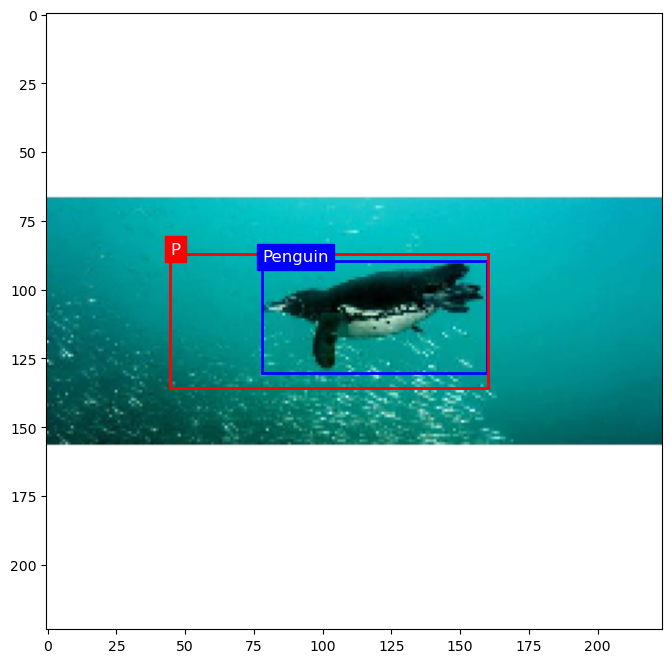

(67.54999732971191, 80.85000133514404, 193.2000026702881, 158.90000534057617)
(60.43366622924805, 106.32344150543213, 163.4073314666748, 150.67825508117676)


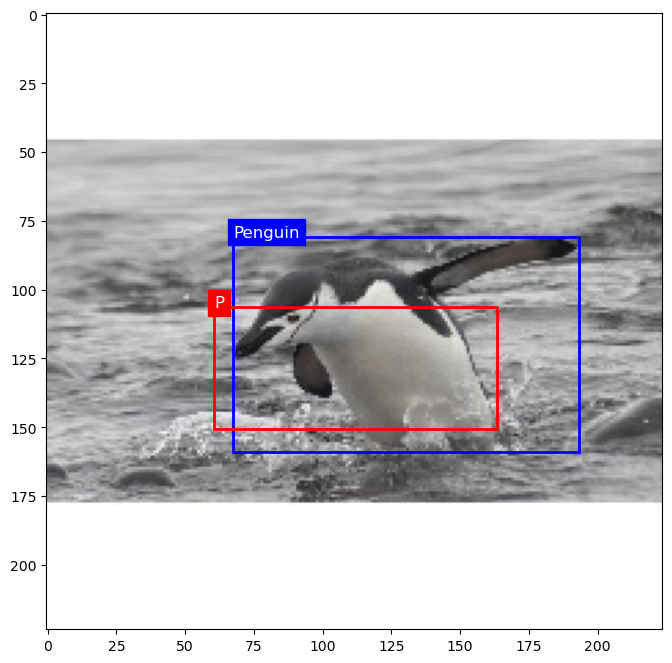

(21.34999966621399, 44.44999933242798, 179.90000534057617, 203.0)
(15.424054622650146, 68.15153312683105, 205.6718235015869, 191.93829154968262)


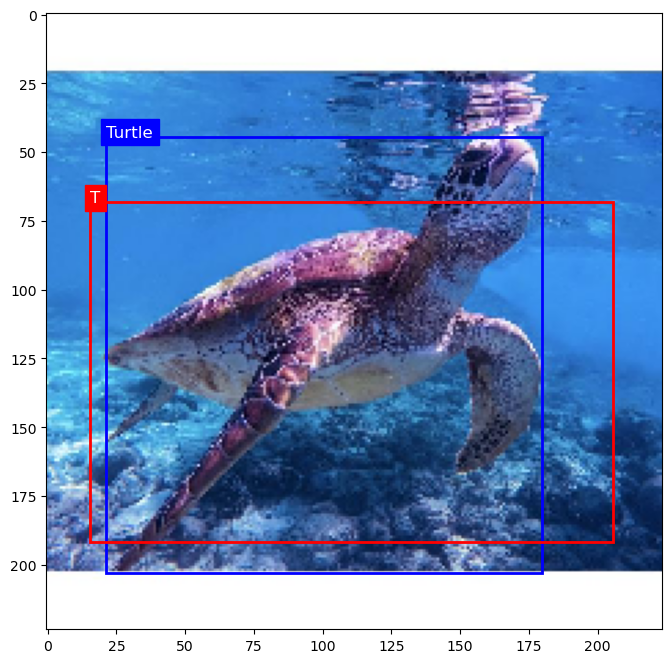

(59.85000133514404, 103.95000267028809, 162.40000534057617, 154.0)
(68.36563682556152, 121.7508773803711, 157.66120529174805, 185.04004287719727)


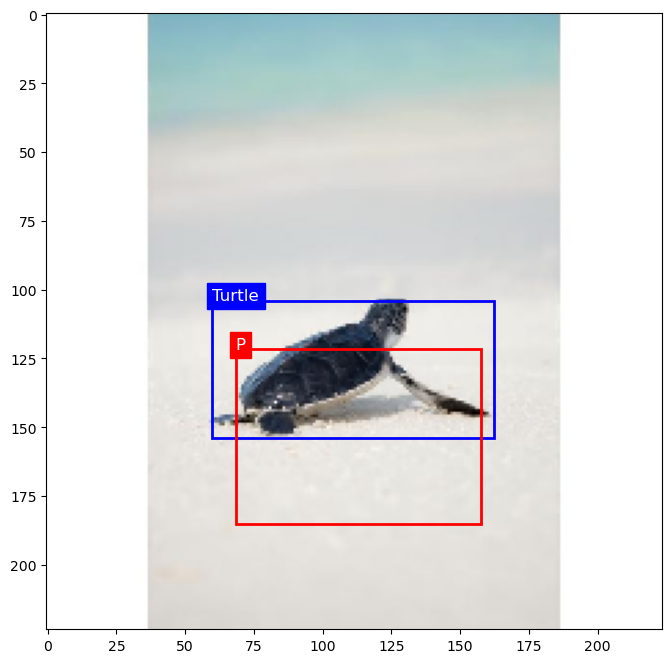

(26.59999966621399, 62.64999866485596, 168.7000026702881, 186.90000534057617)
(16.72384738922119, 69.66818332672119, 169.9280014038086, 192.24080848693848)


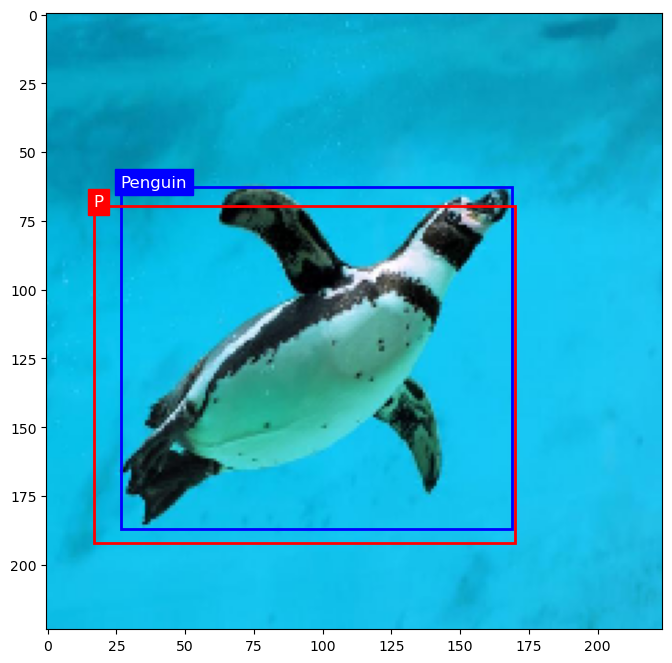

(26.25, 107.10000133514404, 148.0499973297119, 157.5)
(20.91777515411377, 117.76205444335938, 155.18020057678223, 169.73262977600098)


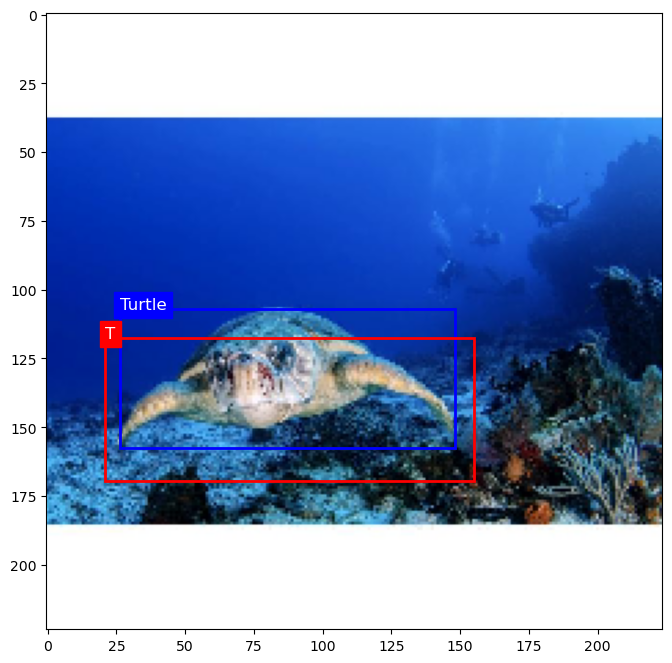

(80.85000133514404, 116.54999732971191, 121.09999465942383, 138.59999465942383)
(72.6093521118164, 115.19676208496094, 135.76790046691895, 145.57787132263184)


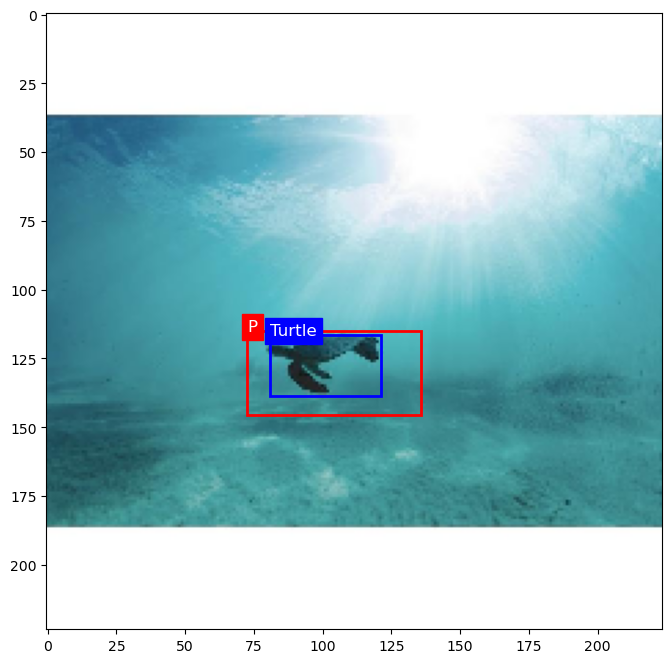

(54.25, 56.35000133514404, 171.15000534057617, 170.09999465942383)
(16.917958974838257, 58.801939964294434, 188.5799903869629, 190.45423889160156)


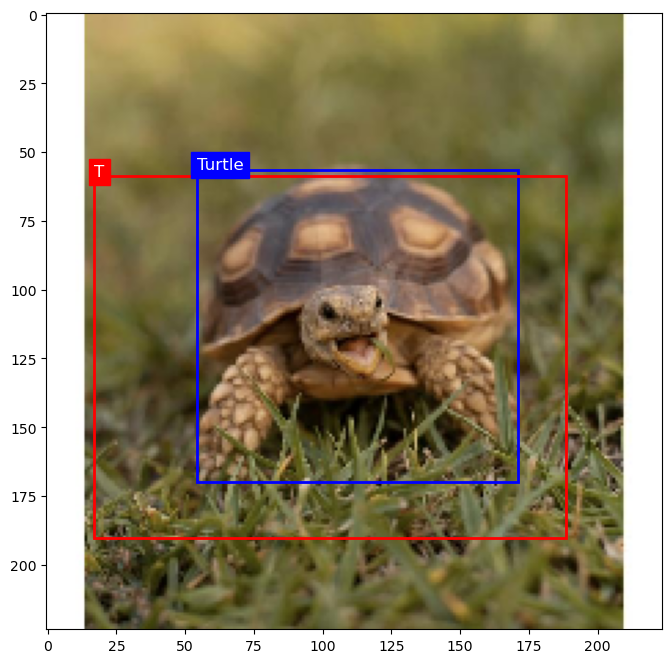

(19.59999966621399, 65.10000133514404, 209.65000534057617, 161.0)
(4.934653997421265, 77.85550689697266, 206.1971893310547, 167.6024341583252)


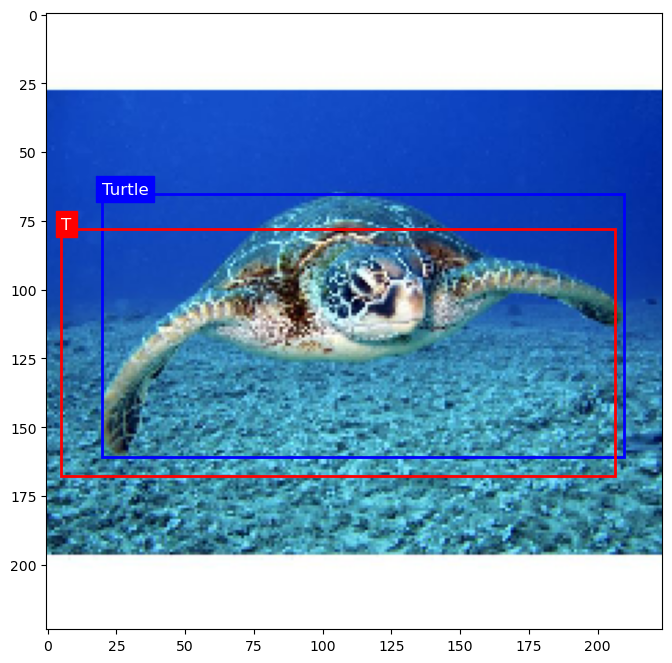

(90.29999732971191, 102.89999866485596, 123.20000267028809, 163.7999973297119)
(65.74267292022705, 108.67693996429443, 137.3850269317627, 157.58173751831055)


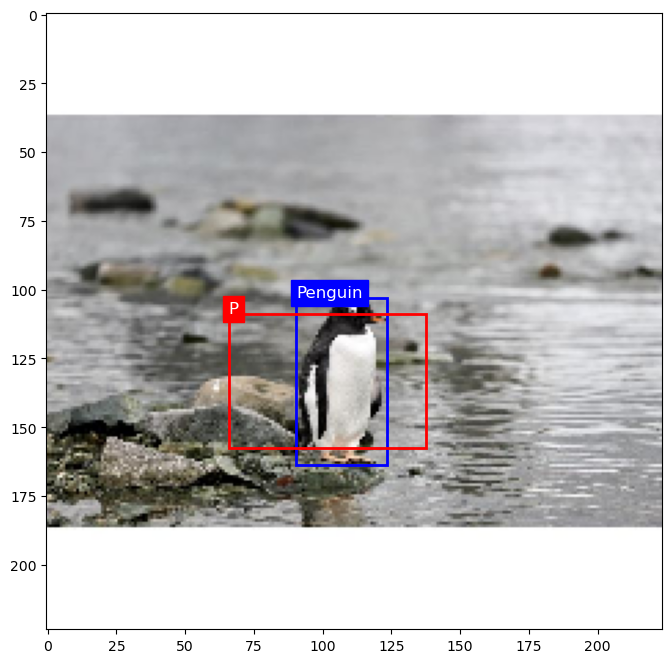

(67.54999732971191, 53.19999933242798, 117.25, 180.25)
(24.828797578811646, 66.57579612731934, 182.68312644958496, 174.17606925964355)


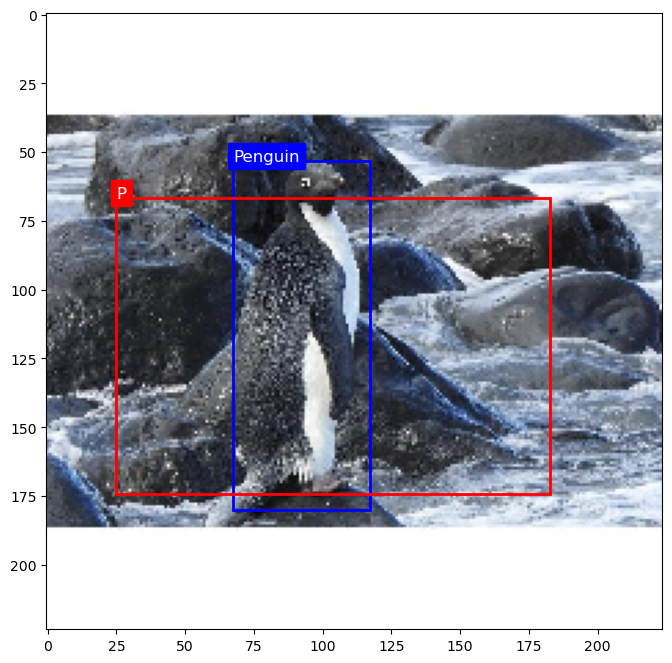

(58.799997329711914, 63.0, 224.0, 144.90000534057617)
(39.04282283782959, 77.40684509277344, 176.85406112670898, 151.002347946167)


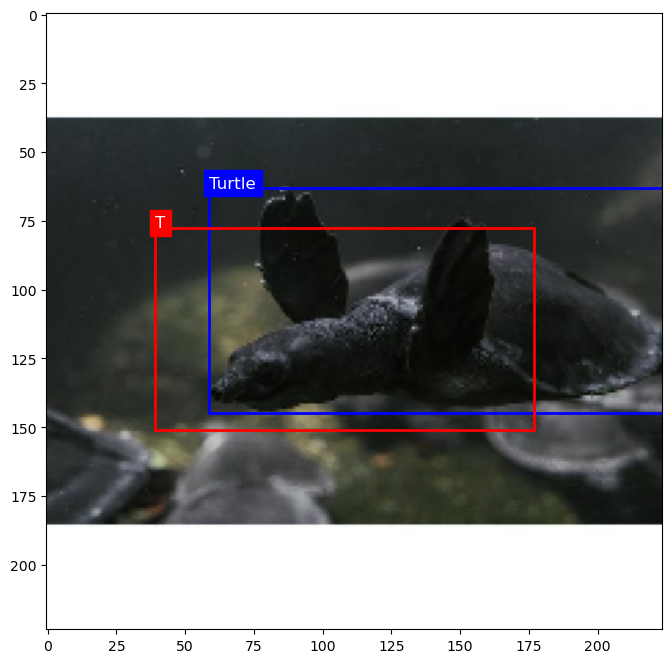

(32.89999866485596, 87.85000133514404, 175.0, 200.5499973297119)
(24.79569101333618, 72.85722827911377, 185.94960975646973, 186.841646194458)


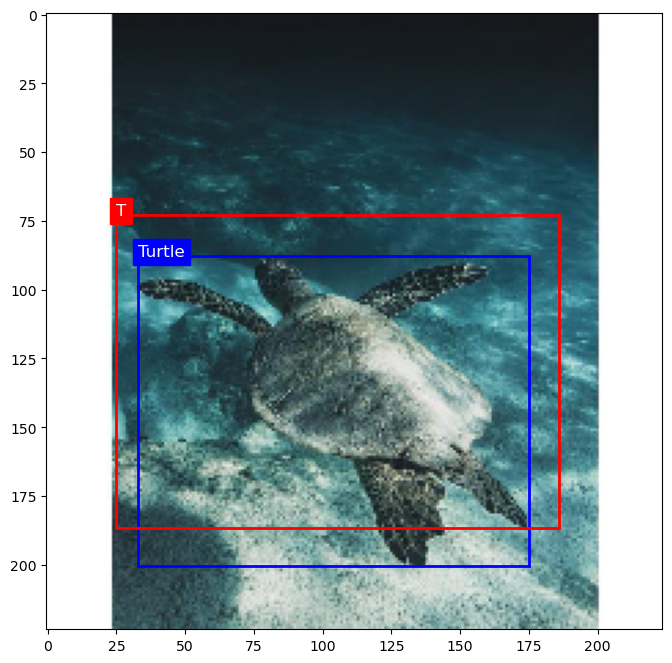

(81.20000267028809, 80.5, 204.75, 141.75)
(66.52186965942383, 104.15088176727295, 186.0524959564209, 139.23866081237793)


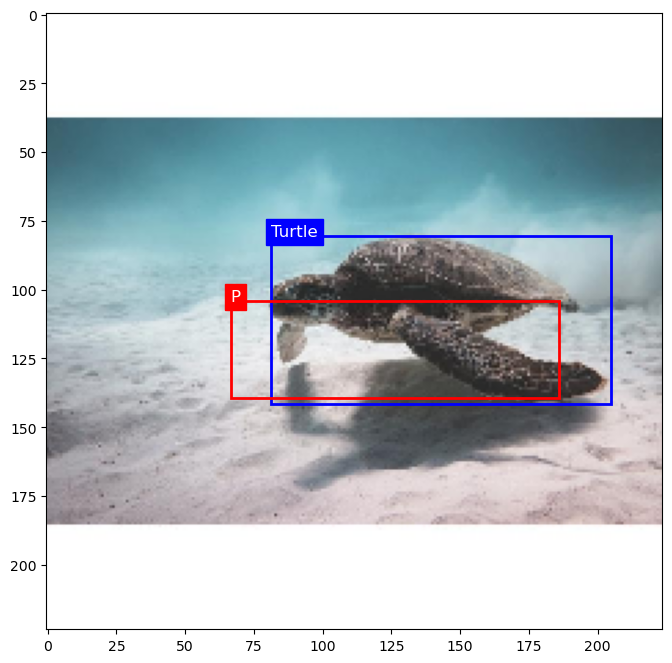

(110.60000133514404, 88.20000267028809, 182.0, 178.15000534057617)
(85.44415187835693, 86.76640510559082, 191.1758041381836, 176.5724391937256)


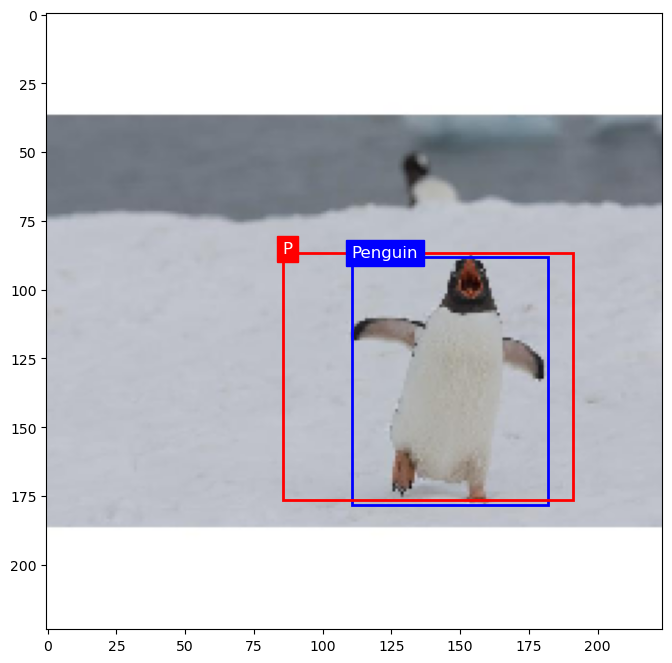

(34.64999866485596, 28.350001335144043, 203.7000026702881, 196.34999465942383)
(13.75697124004364, 68.95932865142822, 181.88497734069824, 198.08247756958008)


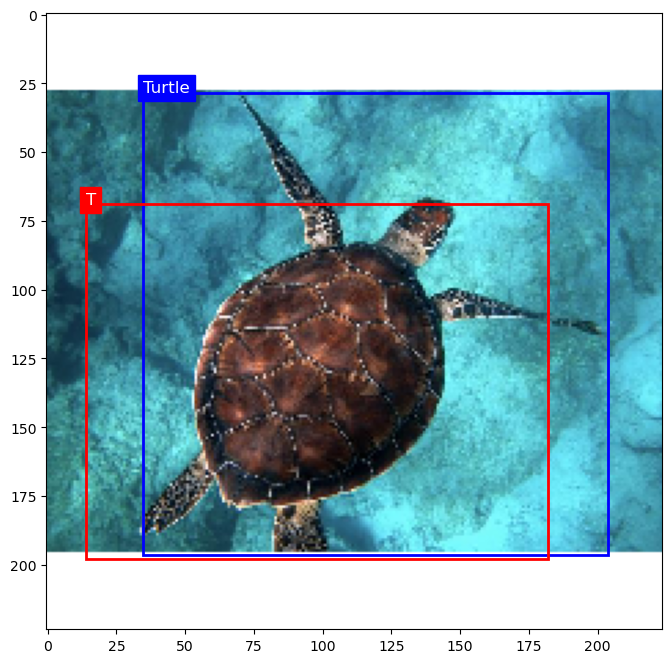

(88.20000267028809, 75.25, 183.40000534057617, 134.40000534057617)
(66.1268539428711, 82.64962863922119, 192.60646438598633, 152.3563575744629)


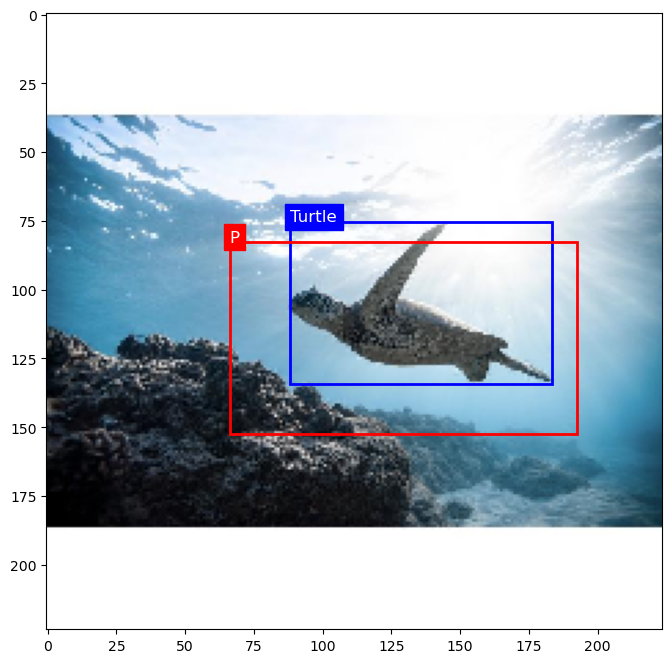

(61.950002670288086, 71.39999866485596, 161.34999465942383, 142.09999465942383)
(50.02671241760254, 82.67979621887207, 172.8576946258545, 172.46920776367188)


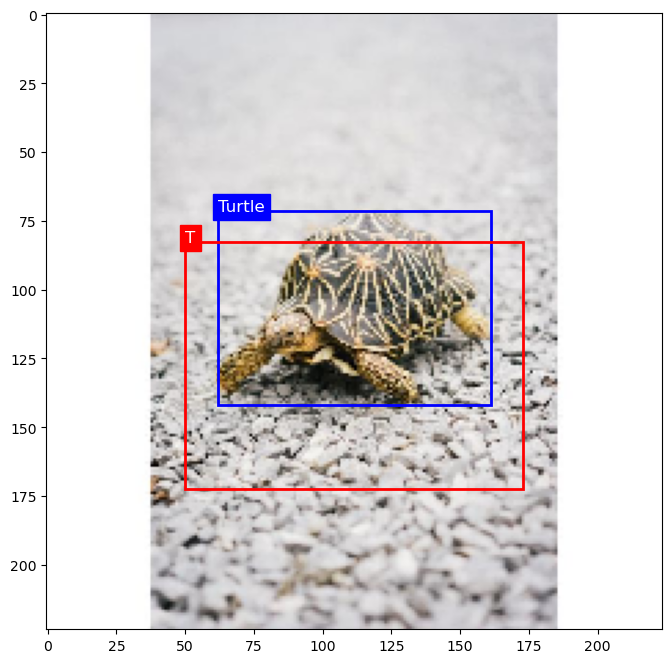

(45.5, 53.89999866485596, 142.09999465942383, 159.9500026702881)
(34.07387065887451, 57.97038555145264, 161.8682975769043, 151.55896949768066)


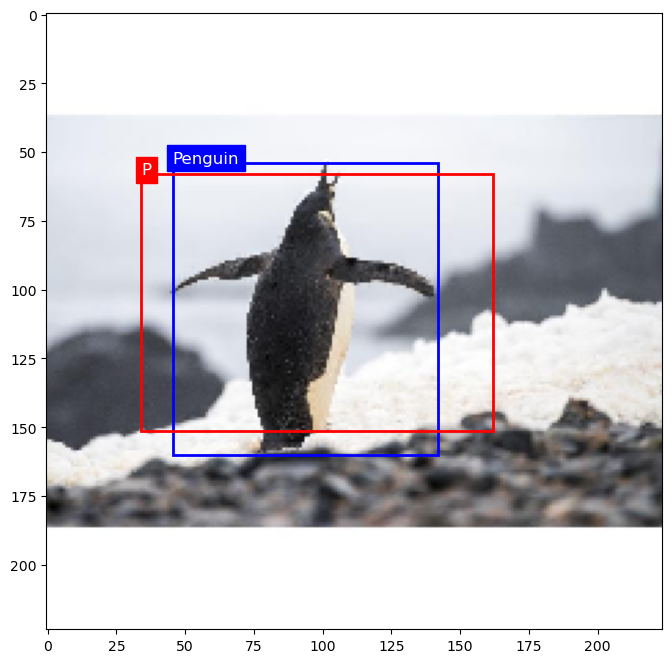

(69.64999866485596, 69.64999866485596, 151.5499973297119, 151.2000026702881)
(57.636192321777344, 114.14951515197754, 150.1701259613037, 160.30724716186523)


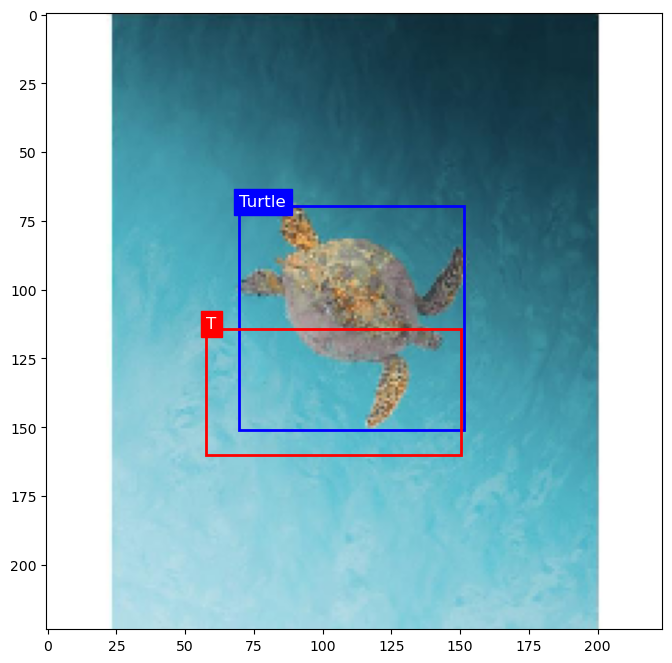

(79.79999732971191, 59.5, 201.25, 194.9500026702881)
(82.49616050720215, 53.6633243560791, 196.85135459899902, 193.15547561645508)


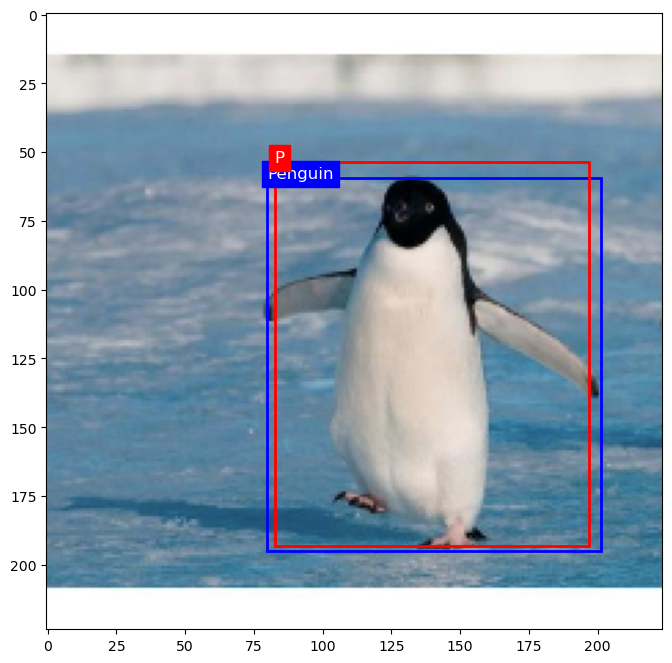

(84.0, 64.39999866485596, 138.59999465942383, 138.9500026702881)
(33.54674577713013, 69.62760829925537, 164.45292282104492, 164.48815727233887)


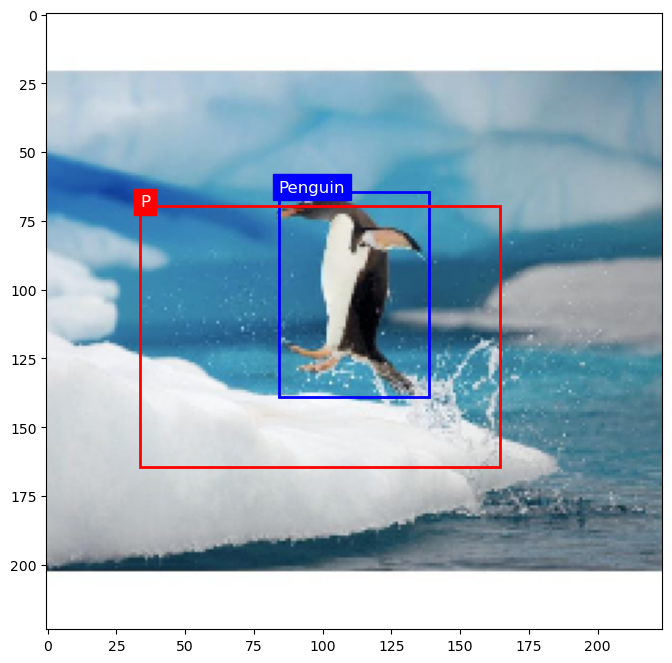

(0.3500000052154064, 80.14999866485596, 204.40000534057617, 179.90000534057617)
(4.968551218509674, 87.77656173706055, 213.72208786010742, 171.35677909851074)


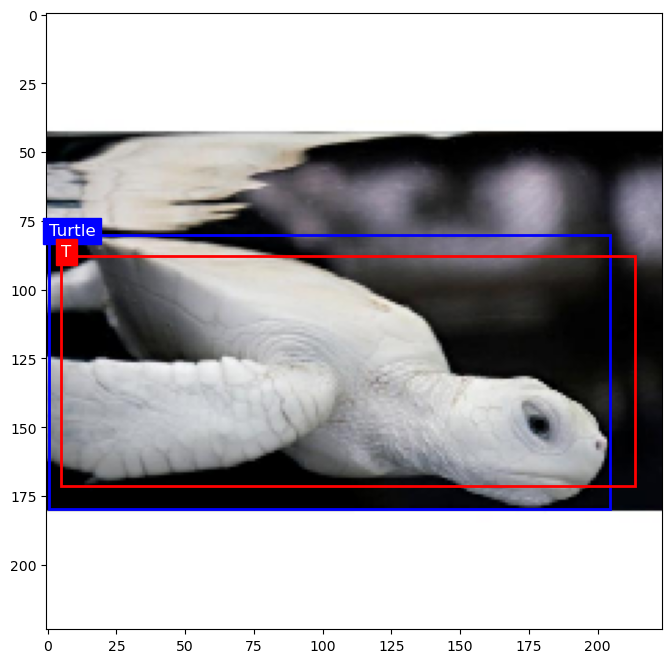

(33.94999933242798, 44.80000066757202, 164.15000534057617, 186.5499973297119)
(32.72162342071533, 52.93822431564331, 206.4150047302246, 182.79258155822754)


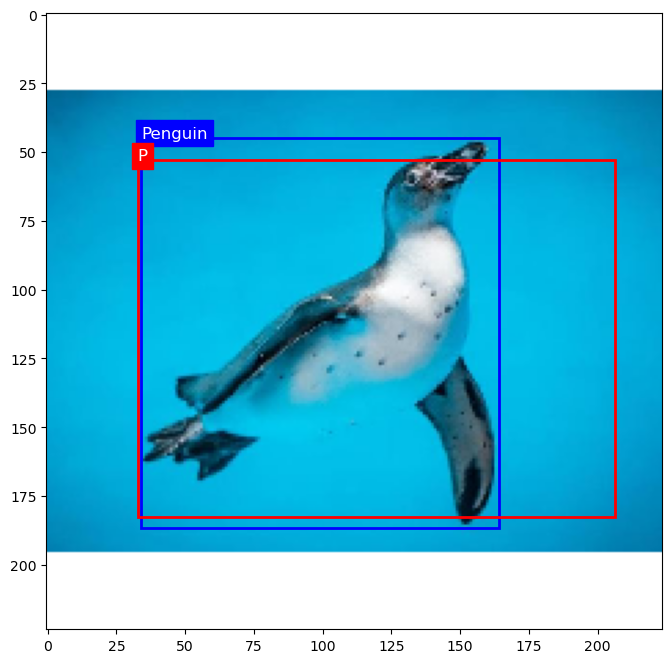

(60.89999866485596, 85.75, 144.2000026702881, 131.9500026702881)
(41.92396020889282, 99.70568656921387, 163.49526405334473, 147.3291130065918)


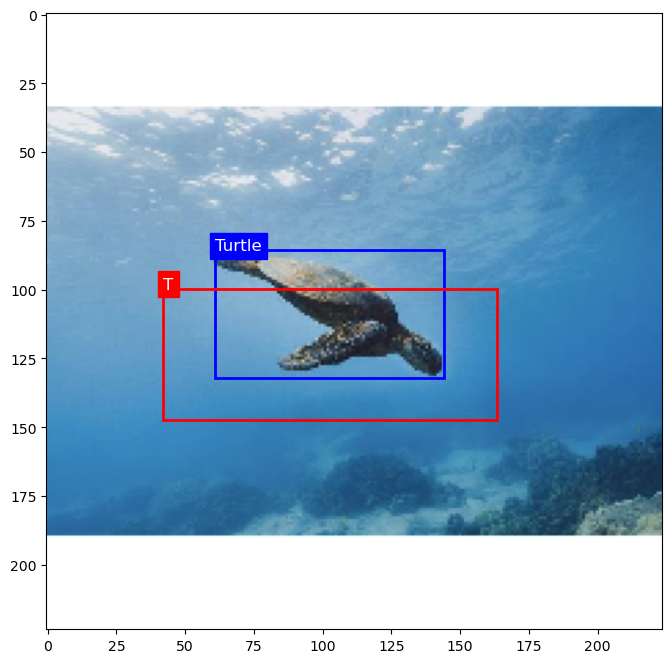

(48.64999866485596, 67.20000267028809, 125.65000534057617, 148.40000534057617)
(27.42064595222473, 77.51330947875977, 127.06888961791992, 183.78316497802734)


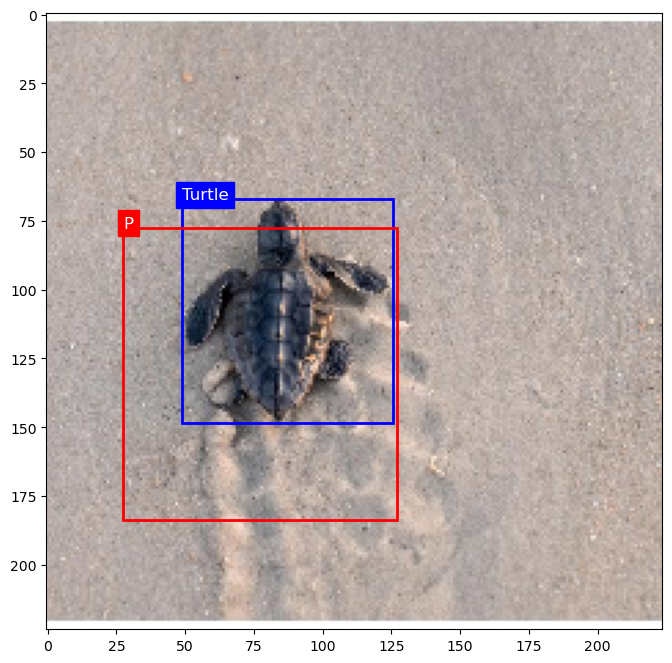

(78.39999866485596, 86.10000133514404, 157.15000534057617, 163.7999973297119)
(80.75712871551514, 110.39795398712158, 144.90521240234375, 173.47975158691406)


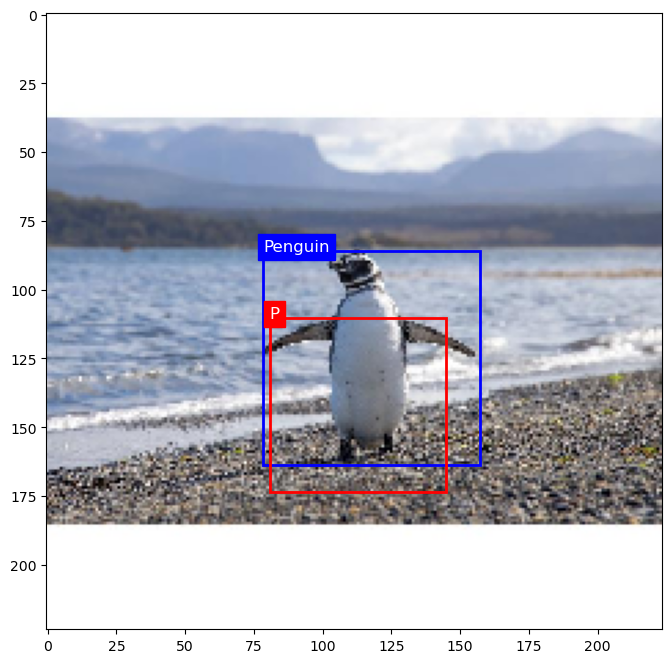

(59.14999866485596, 16.80000066757202, 184.4500026702881, 205.4500026702881)
(34.870460987091064, 24.367204904556274, 194.35921478271484, 209.34696769714355)


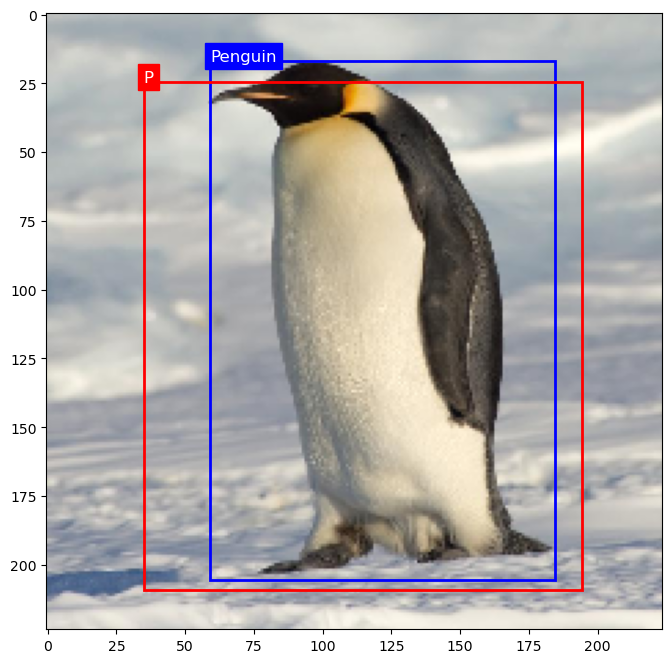

(62.299997329711914, 87.85000133514404, 84.0, 133.7000026702881)
(36.04155254364014, 98.69626426696777, 147.979154586792, 147.1628074645996)


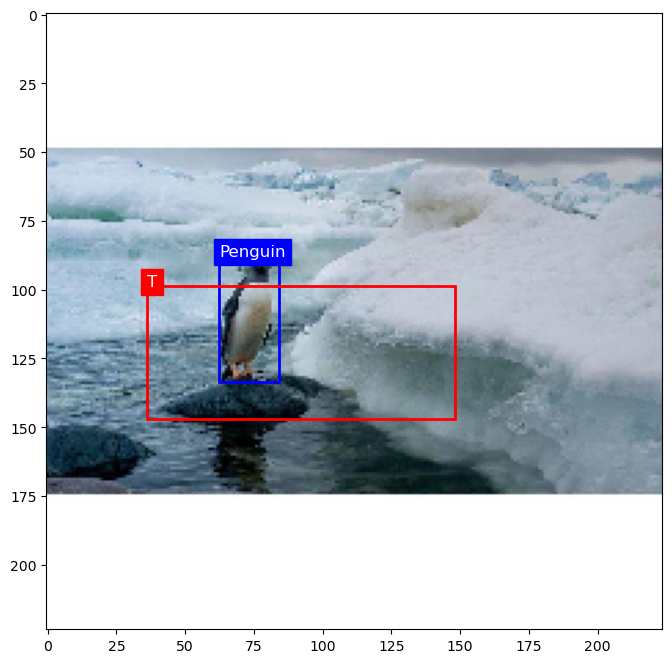

(92.04999732971191, 44.44999933242798, 222.59999465942383, 183.75)
(82.3244743347168, 52.81347846984863, 202.56392860412598, 194.28873252868652)


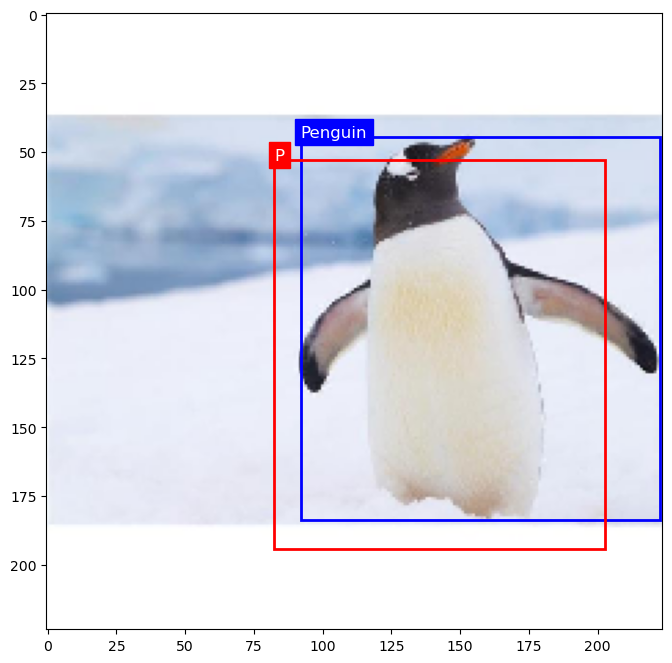

(75.95000267028809, 120.40000534057617, 183.0499973297119, 212.09999465942383)
(44.521586418151855, 123.45956802368164, 174.16972732543945, 196.4715461730957)


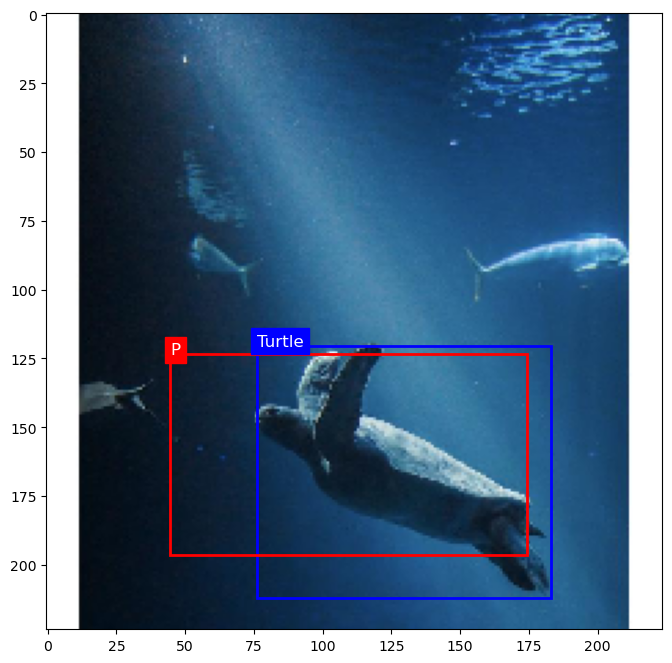

(26.59999966621399, 63.35000133514404, 182.0, 163.09999465942383)
(19.138941049575806, 69.91384315490723, 184.0064811706543, 153.2919864654541)


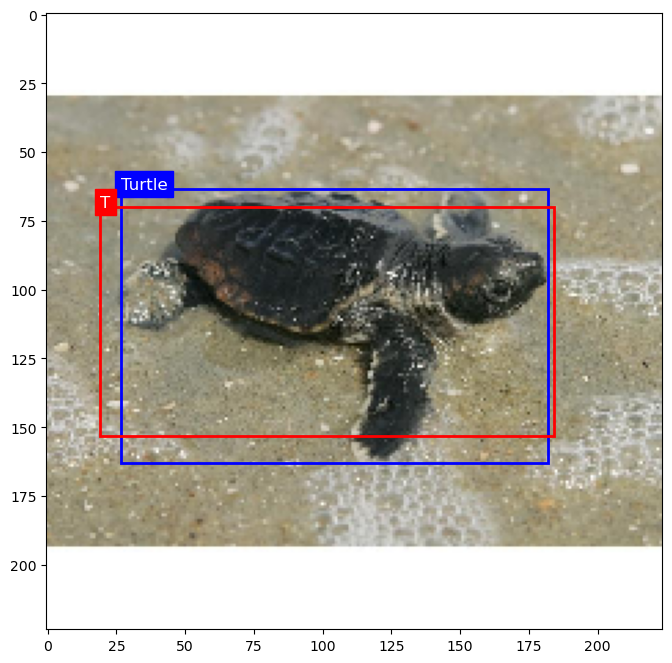

(68.95000267028809, 44.44999933242798, 223.65000534057617, 163.7999973297119)
(43.936336040496826, 59.58253192901611, 200.2976951599121, 147.38482856750488)


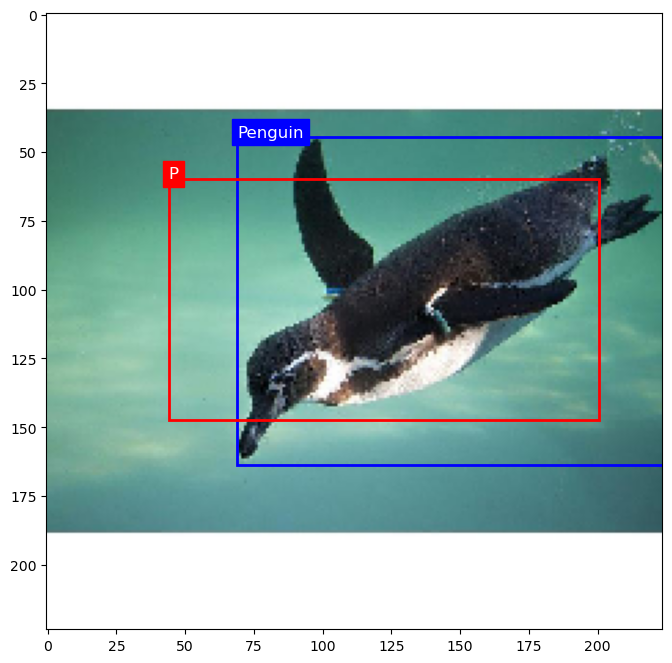

(86.79999732971191, 67.20000267028809, 142.09999465942383, 180.25)
(73.46917819976807, 70.95256519317627, 174.59781455993652, 190.28343391418457)


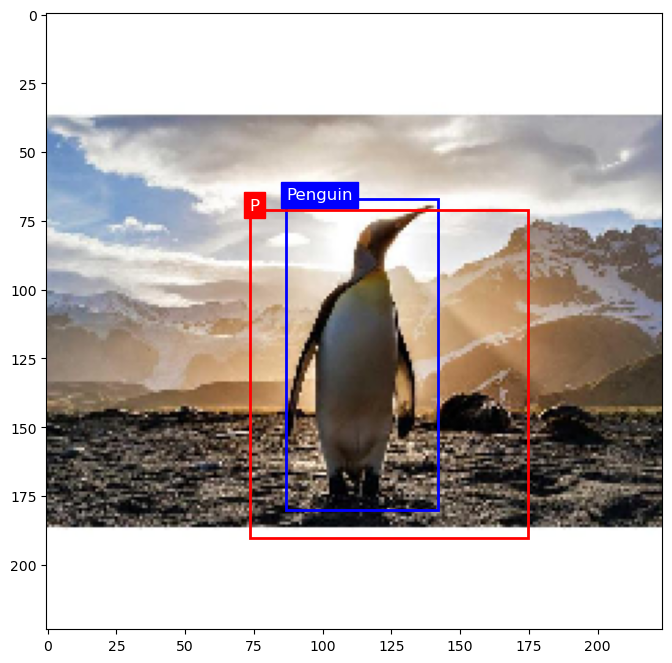

(9.799999833106995, 72.10000133514404, 169.40000534057617, 186.90000534057617)
(35.32726716995239, 71.12897109985352, 185.45428466796875, 180.63783264160156)


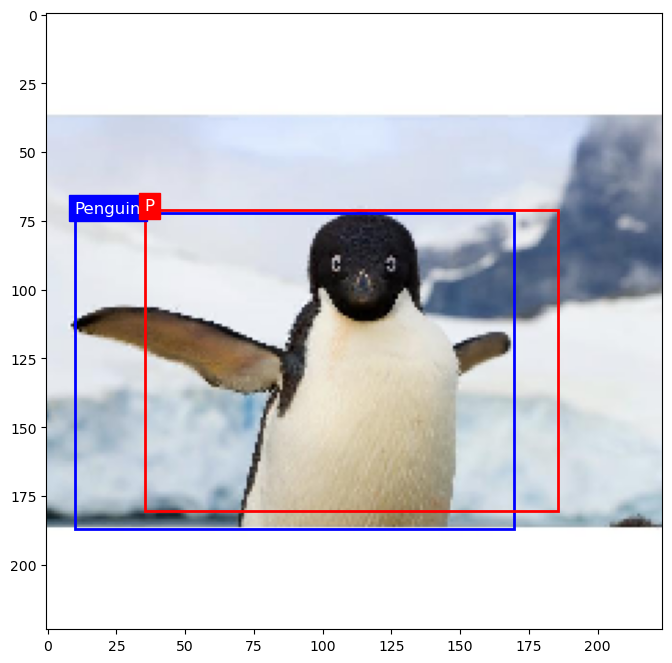

(18.55000066757202, 56.700002670288086, 113.75, 173.9500026702881)
(8.42904806137085, 59.27037525177002, 128.05076789855957, 174.4347801208496)


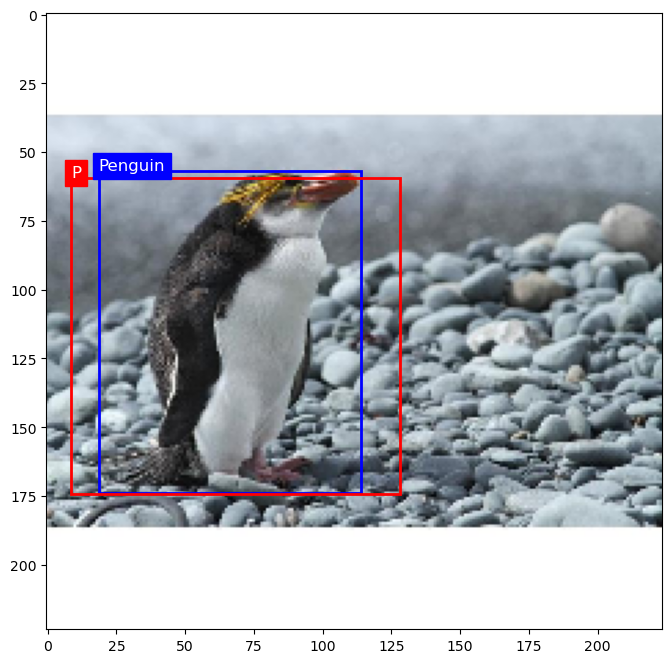

(91.0, 69.29999732971191, 188.65000534057617, 171.15000534057617)
(11.281185269355774, 16.020400047302246, 223.68319702148438, 213.48756980895996)


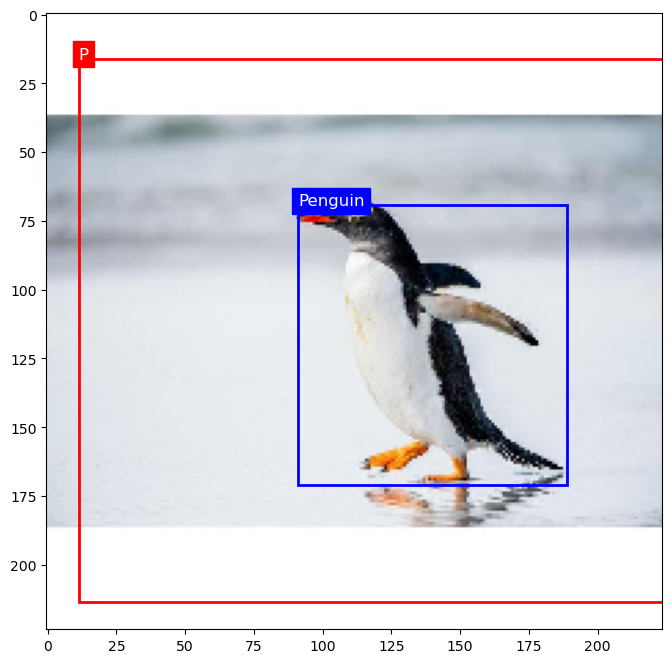

(47.94999933242798, 32.55000066757202, 195.2999973297119, 97.29999732971191)
(3.4914680123329163, 19.057899475097656, 213.1819019317627, 180.5189380645752)


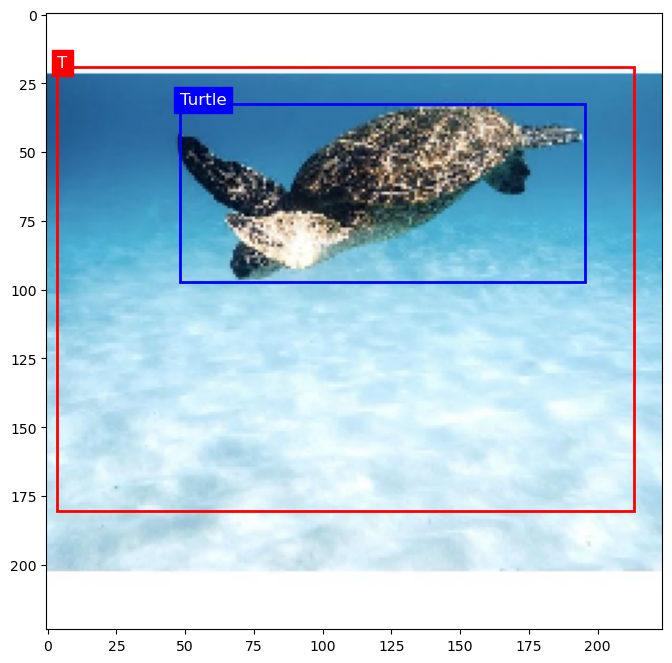

(0.7000000104308128, 102.20000267028809, 158.90000534057617, 161.0)
(1.4356960356235504, 113.78455352783203, 204.39697456359863, 204.78814506530762)


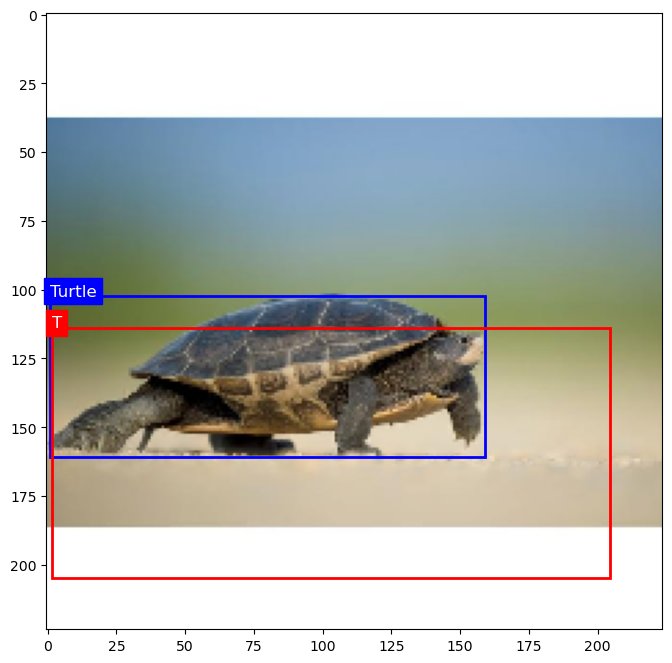

(69.29999732971191, 100.79999732971191, 164.84999465942383, 148.0499973297119)
(3.0712794065475464, 49.653846740722656, 209.1407413482666, 206.80158233642578)


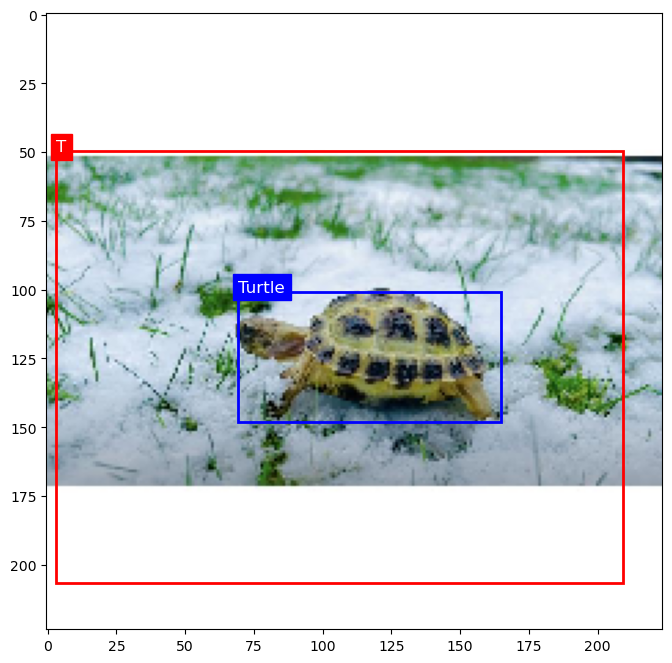

(20.30000066757202, 78.75, 92.04999732971191, 177.7999973297119)
(0.14933356642723083, 25.92554998397827, 211.04902267456055, 222.11727333068848)


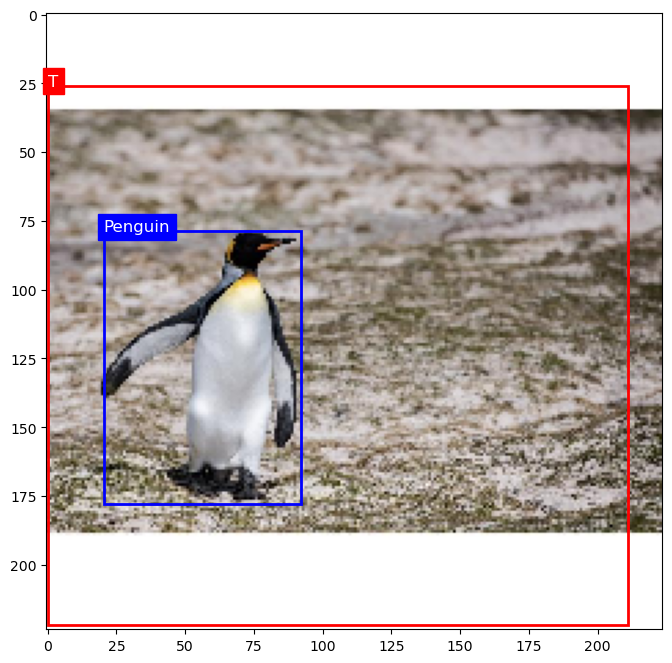

(56.700002670288086, 38.14999866485596, 179.5499973297119, 152.59999465942383)
(0.2796994298696518, 1.0289877951145172, 223.98040008544922, 219.27444458007812)


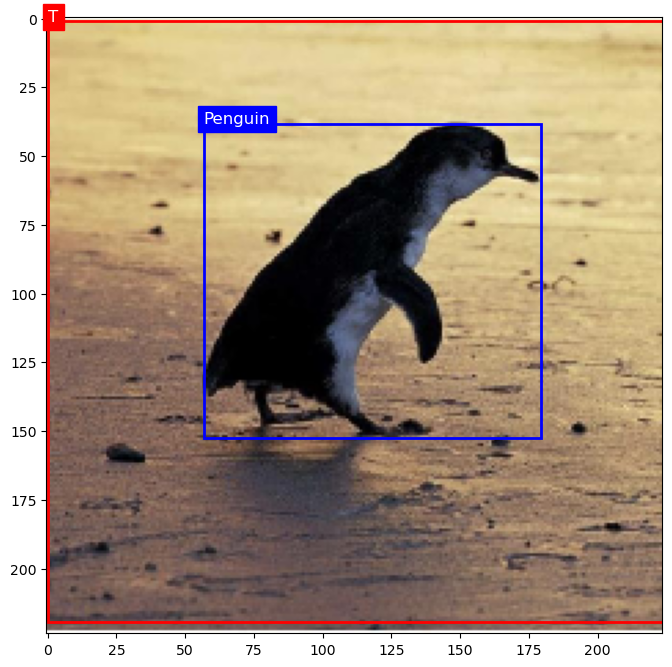

(8.049999833106995, 30.44999933242798, 196.7000026702881, 189.34999465942383)
(0.12450259923934937, 5.187167704105377, 223.72881889343262, 210.19103240966797)


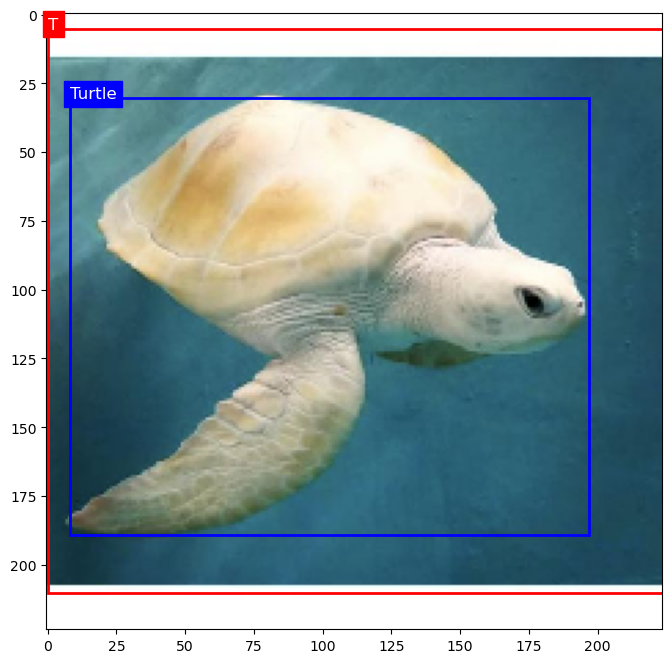

(74.54999732971191, 13.299999833106995, 195.2999973297119, 128.4500026702881)
(4.509651362895966, 3.2626979649066925, 222.1258316040039, 202.1476173400879)


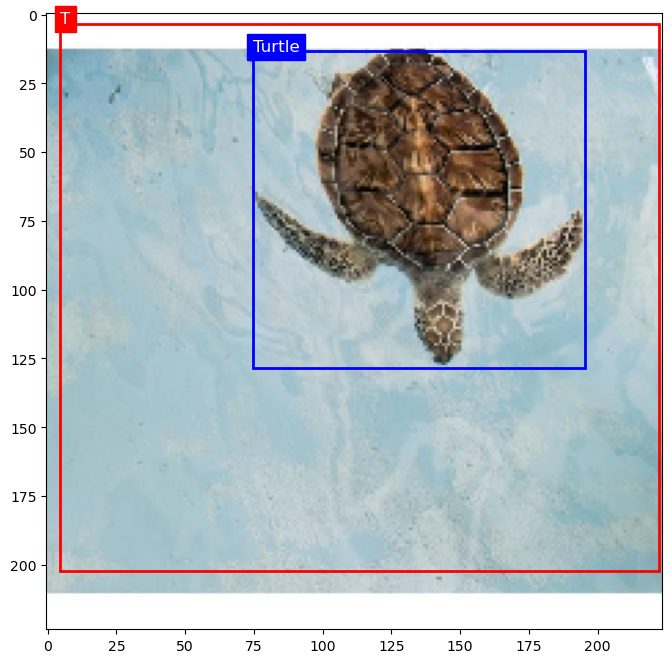

In [ ]:
label_preds, bbox_preds = vgg16_tailored.predict(valid_images)
predicted_label = []
IoU = []
distance = []
for i in range(len(valid_images)):
    display_image = valid_images[i]
    display_bbox = valid_bboxes[i]
    display_label = valid_labels[i]
    
    input_image = np.expand_dims(display_image, axis=0)
    
    bbox_pred = bbox_preds[i]
    label_pred = label_preds[i]
    
    i = np.argmax(label_pred)
    label_pred = lb.classes_[i][0]
    
    if label_pred == 'P':
        predicted_label.append('Penguin')
    else:
        predicted_label.append('Turtle')
        
    IoU.append(calculate_iou(bbox_pred, display_bbox))
    distance.append(calculate_distance_between_centers(bbox_pred, display_bbox))
    
    plt.figure(figsize=(8, 8))
    plt.imshow(np.uint8(display_image*255.0))

    minx, miny, maxx, maxy = display_bbox
    print((minx*224, miny*224, maxx*224, maxy*224))
    rect = plt.Rectangle((minx*224, miny*224), (maxx - minx )*224, (maxy - miny )*224, linewidth=2, edgecolor='b', facecolor='none')
    plt.gca().add_patch(rect)
    plt.text(minx*224, miny*224, display_label, fontsize=12, color='white', backgroundcolor='blue')
    
    minx, miny, maxx, maxy = bbox_pred
    print((minx*224, miny*224, maxx*224, maxy*224))
    rect1 = plt.Rectangle((minx*224.0, miny*224.0), (maxx - minx )*224.0, (maxy - miny )*224.0, linewidth=2, edgecolor='r', facecolor='none')
    plt.gca().add_patch(rect1)
    plt.text(minx*224, miny*224, label_pred, fontsize=12, color='white', backgroundcolor='red')
    
    plt.show()
    
    


In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
import statistics

print(f"Confusion matrix: \n {confusion_matrix(valid_labels, predicted_label)}")
print(f"Accuracy: {accuracy_score(valid_labels, predicted_label)} \nPrecision-Penguin: {precision_score(valid_labels, predicted_label, pos_label='Penguin')} \nRecall-Penguin: {recall_score(valid_labels, predicted_label,pos_label='Penguin')} \nF1-Penguin: {f1_score(valid_labels, predicted_label, pos_label='Penguin')}\n\nPrecision-Turtle: {precision_score(valid_labels, predicted_label, pos_label='Turtle')} \nRecall-Turtle: {recall_score(valid_labels, predicted_label,pos_label='Turtle')} \nF1-Turtle: {f1_score(valid_labels, predicted_label, pos_label='Turtle')}")

iou_stdev = statistics.stdev(IoU)
iou_mean = sum(IoU)/len(IoU)
dis_stdev = statistics.stdev(distance)
dis_mean = sum(distance) / len(distance)

print(f"\nIoU standard deviation: {iou_stdev} \n \tMean: {iou_mean}")
print(f"Distance between centers of boxes: {dis_stdev}           \n \tMean: {dis_mean}")

Confusion matrix: 
 [[32  4]
 [ 8 28]]
Accuracy: 0.8333333333333334 
Precision-Penguin: 0.8 
Recall-Penguin: 0.8888888888888888 
F1-Penguin: 0.8421052631578948

Precision-Turtle: 0.875 
Recall-Turtle: 0.7777777777777778 
F1-Turtle: 0.823529411764706

IoU standard deviation: 0.09464750686436507 
 	Mean: 0.819142196012951
Distance between centers of boxes: 0.0427533934629789           
 	Mean: 0.07729502742433052


# EfficientNetV2S

In [ ]:
!pip install -U keras-efficientnet-v2
import tensorflow as tf
import keras_efficientnet_v2
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import LearningRateScheduler
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.regularizers import l2

base_model = keras_efficientnet_v2.EfficientNetV2S(
    num_classes=0,
    input_shape=(224, 224, 3),
    dropout=1e-6,
    pretrained="imagenet21k"
)
initializer = tf.keras.initializers.VarianceScaling(scale=0.1, mode='fan_in', distribution='uniform')

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu', kernel_regularizer=l2(0.01))(x)
x = Dense(256, activation='relu',kernel_regularizer=l2(0.01),kernel_initializer=tf.keras.initializers.VarianceScaling(scale=0.1, mode='fan_in', distribution='uniform', seed=42)
          )(x)
predictions = Dense(2, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

for layer in model.layers:
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = True
    else:
        layer.trainable = False

epochs=5
def lr_schedule(epoch, lr):
    if epoch < 0.5 * epochs:
        return lr
    elif epoch < 0.9 * epochs:
        return lr * 0.1
    else:
        return lr * 0.01

lr_scheduler = LearningRateScheduler(lr_schedule)
model.compile(loss='categorical_crossentropy', optimizer=Adam(), metrics=['accuracy'])


/opt/conda/lib/python3.10/site-packages/keras/initializers/initializers.py:120: UserWarning: The initializer VarianceScaling is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.
  warnings.warn(


194646348/194646348 [==============================] - 3s 0us/step
>>>> Load pretrained from: /root/.keras/models/efficientnetv2/efficientnetv2-s-21k.h5


In [ ]:
model.fit(
    train_images, train_labels,
    epochs=epochs,
    validation_data=(test_images, test_labels)
)

Epoch 1/5
13/13 [==============================] - 56s 608ms/step - loss: 3.3943 - accuracy: 0.4825 - val_loss: 3.3285 - val_accuracy: 0.5100
Epoch 2/5
13/13 [==============================] - 3s 213ms/step - loss: 3.3133 - accuracy: 0.5225 - val_loss: 3.2752 - val_accuracy: 0.5200
Epoch 3/5
13/13 [==============================] - 3s 218ms/step - loss: 3.2445 - accuracy: 0.5550 - val_loss: 3.2422 - val_accuracy: 0.5300
Epoch 4/5
13/13 [==============================] - 3s 214ms/step - loss: 3.1812 - accuracy: 0.6300 - val_loss: 3.1961 - val_accuracy: 0.5700
Epoch 5/5
13/13 [==============================] - 3s 221ms/step - loss: 3.1298 - accuracy: 0.6925 - val_loss: 3.1673 - val_accuracy: 0.6200


In [ ]:
model.fit(
    train_images, train_labels,
    epochs=epochs,
    validation_data=(test_images, test_labels)
)

Epoch 1/5
13/13 [==============================] - 3s 232ms/step - loss: 2.9194 - accuracy: 0.9625 - val_loss: 3.0120 - val_accuracy: 0.8300
Epoch 2/5
13/13 [==============================] - 3s 217ms/step - loss: 2.9089 - accuracy: 0.9575 - val_loss: 2.9894 - val_accuracy: 0.8400
Epoch 3/5
13/13 [==============================] - 3s 211ms/step - loss: 2.8835 - accuracy: 0.9725 - val_loss: 2.9713 - val_accuracy: 0.8700
Epoch 4/5
13/13 [==============================] - 3s 217ms/step - loss: 2.8604 - accuracy: 0.9775 - val_loss: 2.9527 - val_accuracy: 0.8700
Epoch 5/5
13/13 [==============================] - 3s 217ms/step - loss: 2.8371 - accuracy: 0.9900 - val_loss: 2.9344 - val_accuracy: 0.9000


In [ ]:
model.fit(
    train_images, train_labels,
    epochs=10,
    validation_data=(test_images, test_labels)
)

Epoch 1/10
13/13 [==============================] - 3s 224ms/step - loss: 2.8240 - accuracy: 0.9875 - val_loss: 2.9232 - val_accuracy: 0.9000
Epoch 2/10
13/13 [==============================] - 3s 210ms/step - loss: 2.8102 - accuracy: 0.9900 - val_loss: 2.9093 - val_accuracy: 0.9100
Epoch 3/10
13/13 [==============================] - 3s 218ms/step - loss: 2.7928 - accuracy: 0.9950 - val_loss: 2.8965 - val_accuracy: 0.8900
Epoch 4/10
13/13 [==============================] - 3s 217ms/step - loss: 2.7791 - accuracy: 0.9950 - val_loss: 2.8842 - val_accuracy: 0.9100
Epoch 5/10
13/13 [==============================] - 3s 216ms/step - loss: 2.7582 - accuracy: 0.9950 - val_loss: 2.8674 - val_accuracy: 0.9300
Epoch 6/10
13/13 [==============================] - 3s 215ms/step - loss: 2.7491 - accuracy: 0.9975 - val_loss: 2.8601 - val_accuracy: 0.9300
Epoch 7/10
13/13 [==============================] - 3s 217ms/step - loss: 2.7368 - accuracy: 0.9950 - val_loss: 2.8480 - val_accuracy: 0.9300
Epoch 

3/3 [==============================] - 3s 326ms/step


Prediction result
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


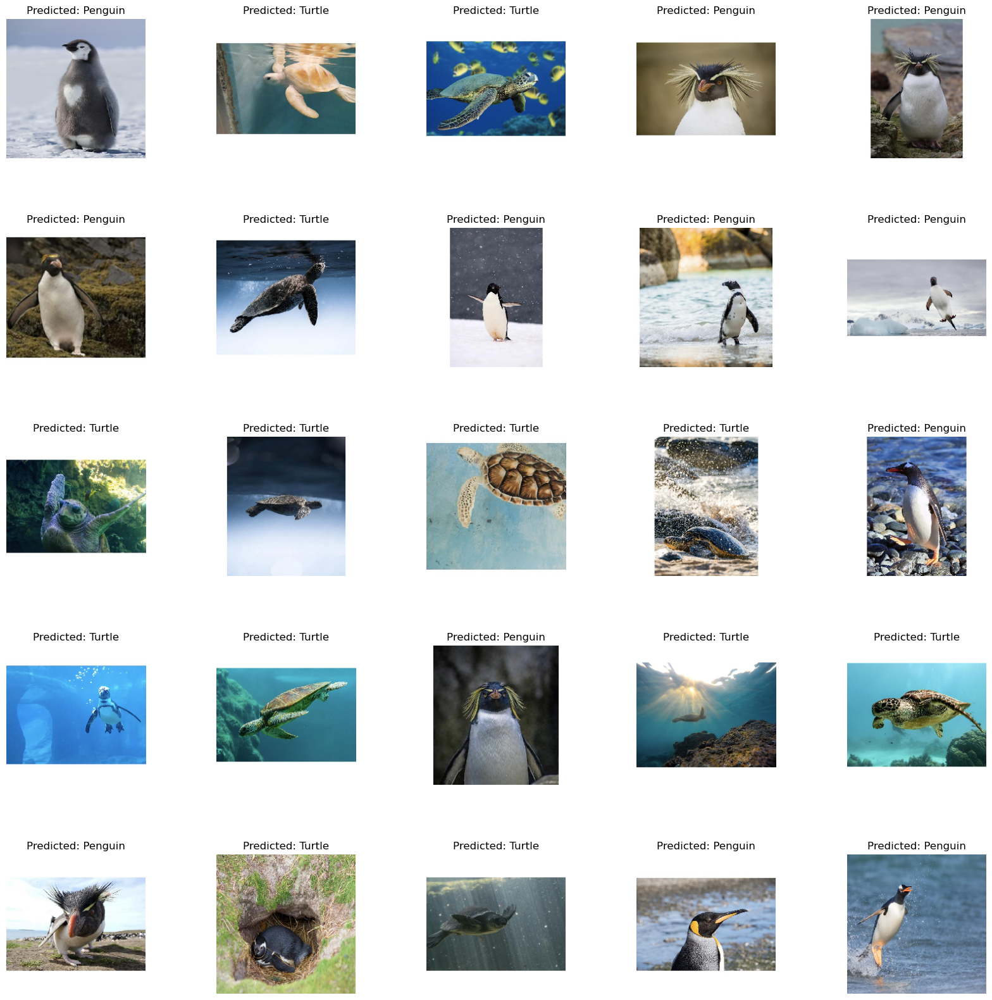

In [ ]:
predictions = model.predict(valid_images)
print("\n")
print("Prediction result")
print("-"*220)


import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec

# Convert predictions to class labels
pred_labels = np.argmax(predictions, axis=1)
pred_labels = lb.inverse_transform(pred_labels) # use the label binarizer to transform labels back to original form


rows = 5
cols = 5

fig = plt.figure(figsize=(20, 20))

# Using GridSpec to add spacing between subplots
gs = gridspec.GridSpec(rows, cols, wspace=0.5, hspace=0.5)

for i in range(rows*cols):
    img = valid_images[i] * 255.0 # Images were scaled down for training. They need to be rescaled to original form for plotting
    ax = fig.add_subplot(gs[i])
    ax.imshow(img.astype(np.uint8)) # Plot image. Cast to uint8 for proper visualization
    ax.set_title("Predicted: " + pred_labels[i]) # Set title to be the predicted label
    ax.axis('off') # Hide axes

plt.show()




### This model can only classify which to which without label box, accuracy approximately around 91%


### Define performace of EfficientNetV2S model

#### Note: As this model isn't predicting bounding boxes in the image. We can't calculate metrics like the distance between predicted and true bounding box centers or Intersection Over Union (IoU). These metrics require both the predicted and true bounding boxes.

In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from tensorflow.keras.metrics import MeanIoU

# Define helper function for IoU calculation
def calc_iou_individual(pred_box, true_box):
    x1_t, y1_t, x2_t, y2_t = true_box
    x1_p, y1_p, x2_p, y2_p = pred_box

    if (x1_p > x2_t) or (y1_p > y2_t) or (x1_t > x2_p) or (y1_t > y2_p):
        return 0.0

    far_x = np.min([x2_t, x2_p])
    near_x = np.max([x1_t, x1_p])
    far_y = np.min([y2_t, y2_p])
    near_y = np.max([y1_t, y1_p])

    inter_area = (far_x - near_x + 1) * (far_y - near_y + 1)
    true_box_area = (x2_t - x1_t + 1) * (y2_t - y1_t + 1)
    pred_box_area = (x2_p - x1_p + 1) * (y2_p - y1_p + 1)
    iou = inter_area / (true_box_area + pred_box_area - inter_area)
    return iou

In [ ]:
from sklearn.preprocessing import LabelEncoder

# assuming the model predicts the class labels
predicted_labels = np.argmax(model.predict(valid_images), axis=1)

# Convert numerical labels back to original (string) labels
label_encoder = LabelEncoder()
label_encoder.fit(['Penguin', 'Turtle'])  # categories known from the problem
predicted_labels = label_encoder.inverse_transform(predicted_labels)

true_labels = valid_labels

cm = confusion_matrix(true_labels, predicted_labels)
print(f'Confusion Matrix: \n{cm}')

# calculate accuracy, precision, recall, f1-score
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='weighted')
recall = recall_score(true_labels, predicted_labels, average='weighted')
f1 = f1_score(true_labels, predicted_labels, average='weighted')

print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1-score: {f1:.4f}')


3/3 [==============================] - 0s 68ms/step
Confusion Matrix: 
[[31  5]
 [ 1 35]]
Accuracy: 0.9167
Precision: 0.9219
Recall: 0.9167
F1-score: 0.9164
